# Figures 3G, H, I, and Supplemental 5

In [18]:
library(Seurat) 
library(Signac) 
library(BSgenome.Hsapiens.UCSC.hg38)
library(JASPAR2018)
library(TFBSTools)
library(chromVAR)
set.seed(1234)
library(openxlsx)
library(here)
library(future)
library(ggplot2)
library(BiocParallel)
library(stringr)
library(harmony)
library(dplyr)
library(RColorBrewer)

In [ ]:
setwd("your/working/dir")

In [3]:
#load integrated seurat object
sobj <- readRDS("path/to/integrated/sobj")

In [13]:
sobj

An object of class Seurat 
344955 features across 7994 samples within 4 assays 
Active assay: SCT (22084 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: ATAC, RNA, PRTB
 5 dimensional reductions calculated: integrated_lsi, atac.umap, pca, rna.umap, wnn.umap

Warning message:
“ggrepel: 21 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 7 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 15 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


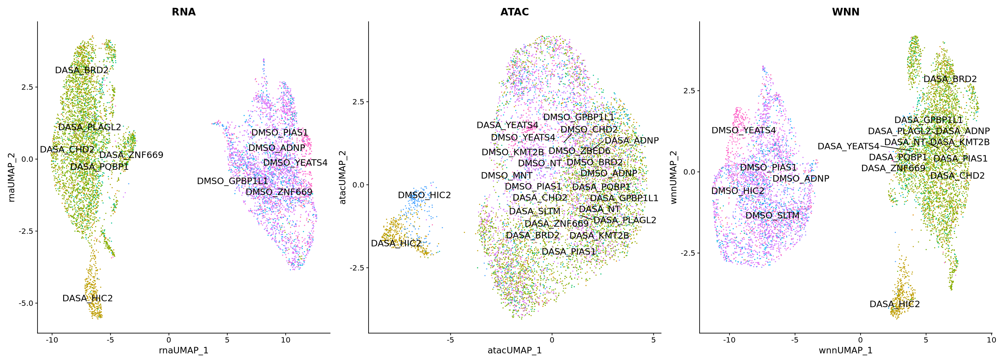

In [24]:
p1 <- DimPlot(sobj, reduction = "rna.umap",  label = TRUE, group.by = "treatment_and_guidecapture", label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(sobj, reduction = "atac.umap", label = TRUE, group.by = "treatment_and_guidecapture",label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(sobj, reduction = "wnn.umap",  label = TRUE, group.by = "treatment_and_guidecapture",label.size = 5, repel = TRUE) + ggtitle("WNN")
options(repr.plot.width=22, repr.plot.height=8)
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

In [26]:
p4 <- FeaturePlot(sobj,features = "HIC2", dims = c(1,2), keep.scale = "feature", reduction = "rna.umap") + scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
p5 <- FeaturePlot(sobj,features = "HIC2", dims = c(1,2), keep.scale = "feature", reduction = "atac.umap") + scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
p6 <- FeaturePlot(sobj,features = "HIC2", dims = c(1,2), keep.scale = "feature", reduction = "wnn.umap") + scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
options(repr.plot.width=22, repr.plot.height=8)
p4 + p5 + p6 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))


Warning message:
“Found the following features in more than one assay, excluding the default. We will not include these in the final data frame: HIC2”
Warning message:
“The following requested variables were not found: HIC2”


ERROR: [1m[33mError[39m in `FeaturePlot()`:[22m
[33m![39m None of the requested features were found: HIC2 in slot  data


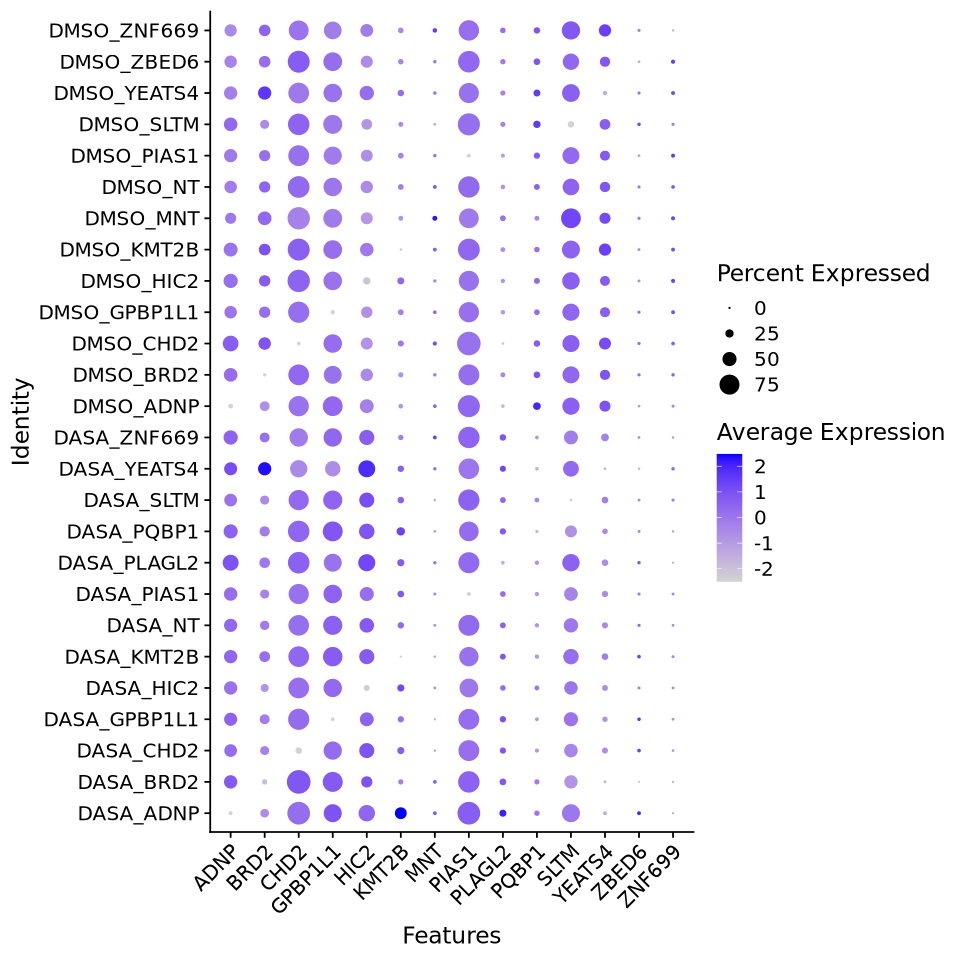

In [28]:
DotPlot(sobj, features = c("ADNP", "BRD2", "CHD2", "GPBP1L1", "HIC2", "KMT2B", "MNT", "PIAS1", "PLAGL2", "PQBP1", "SLTM", "YEATS4", "ZBED6", "ZNF699"), group.by = "treatment_and_guidecapture") + RotatedAxis()
options(repr.plot.width=10, repr.plot.height=8)

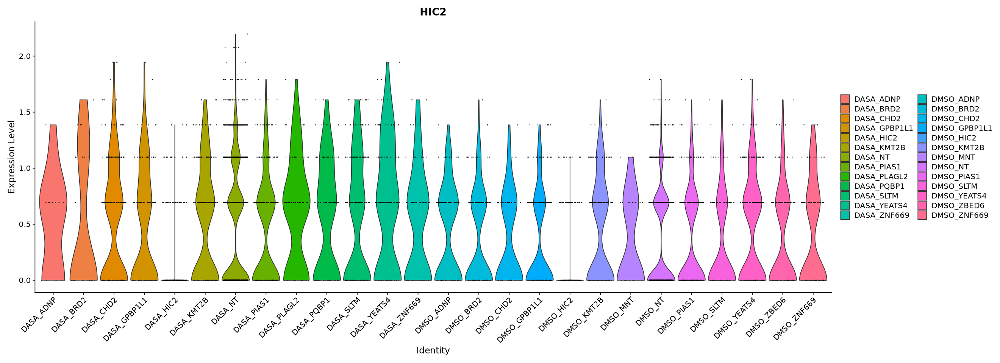

In [28]:
VlnPlot(sobj, features = c("HIC2"), group.by = "treatment_and_guidecapture", assay = "SCT")

In [ ]:
table(sobj$treatment_and_guidecapture)


   DASA_ADNP    DASA_BRD2    DASA_CHD2 DASA_GPBP1L1    DASA_HIC2   DASA_KMT2B 
          15           32          226          131          375          210 
     DASA_NT   DASA_PIAS1  DASA_PLAGL2   DASA_PQBP1    DASA_SLTM  DASA_YEATS4 
        2615          309           83          102          221          121 
 DASA_ZNF669    DMSO_ADNP    DMSO_BRD2    DMSO_CHD2 DMSO_GPBP1L1    DMSO_HIC2 
          79           98          148           51          222          216 
  DMSO_KMT2B     DMSO_MNT      DMSO_NT   DMSO_PIAS1    DMSO_SLTM  DMSO_YEATS4 
         152           27         1661          299          113          241 
  DMSO_ZBED6  DMSO_ZNF669 
         126          121 

In [ ]:
sobj <- RegroupIdents(sobj, metadata = "treatment_and_guidecapture")

In [6]:
Idents(object = sobj) <- "treatment_and_guidecapture"

Warning message:
“ggrepel: 21 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 7 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 15 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


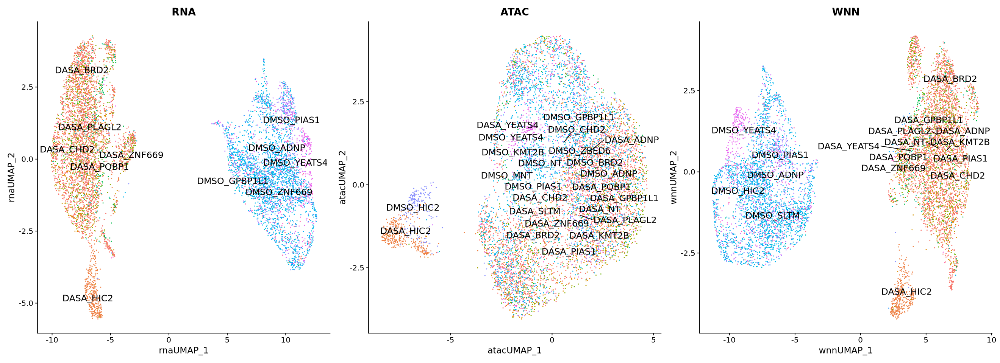

In [ ]:
p1 <- DimPlot(sobj, reduction = "rna.umap",  label = TRUE, label.size = 5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(sobj, reduction = "atac.umap", label = TRUE, label.size = 5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(sobj, reduction = "wnn.umap",  label = TRUE, label.size = 5, repel = TRUE) + ggtitle("WNN")
options(repr.plot.width=22, repr.plot.height=8)
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

In [38]:
# Get a list of motif position weight matrices from the JASPAR database
# Get a list of motif position frequency matrices from the JASPAR database
# 9606 is H.Sapiens NCBI tax ID. 
library(JASPAR2020)
pwm_set <- getMatrixSet(
  x = JASPAR2020,
  opts = list(species = 9606, all_versions = FALSE)
)

In [4]:
sobj
DefaultAssay(sobj) <- "ATAC"
fixed_ranges <- sub("-", ":", row.names(sobj[["ATAC"]]))

# Create a GRanges object
ranges <- GRanges(fixed_ranges)

# Set the genome info
seqlevelsStyle(ranges) <- "UCSC"
genome(ranges) <- "hg38"

# Replace the ranges in the assay
sobj[["ATAC"]]@ranges <- ranges

An object of class Seurat 
344955 features across 7994 samples within 4 assays 
Active assay: SCT (22084 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 3 other assays present: ATAC, RNA, PRTB
 5 dimensional reductions calculated: integrated_lsi, atac.umap, pca, rna.umap, wnn.umap

In [40]:
# Add the Motif object to the assay
# add motif information
library(GenomicRanges)
DefaultAssay(sobj) <- "ATAC"
sobj <- AddMotifs(
  object = sobj,
  genome = BSgenome.Hsapiens.UCSC.hg38,
  pfm = pwm_set
)

Building motif matrix



Finding motif positions



In [ ]:
sobj <- RegionStats(
  object = sobj,
  genome = BSgenome.Hsapiens.UCSC.hg38,
  sep = c(":", "-")
)

In [ ]:
# compute motif activities using chromvar
sobj <- RunChromVAR(
  object = sobj,
  genome = BSgenome.Hsapiens.UCSC.hg38,
)

Computing GC bias per region

Selecting background regions

Computing deviations from background

Constructing chromVAR assay



In [ ]:
GetMotifs <- function(cluster, seurat_aggregate) {
  print(paste0("Finding motifs for: ",cluster))
  sobj <- seurat_aggregate
  DefaultAssay(sobj) <- 'ATAC'
  dac <- FindMarkers(sobj,
                     ident.1 = cluster,
                     test.use = 'wilcox') # find all cluster-specific degs
  enriched.motifs <- FindMotifs(object = sobj, features = rownames(dac[dac$p_val < 0.05, ]))
  return(enriched.motifs)
}

GetChromvarActivities <- function(cluster, seurat_aggregate, motif) {
  print(paste0("Finding chromVAR activities for: ",cluster))
  sobj <- seurat_aggregate
  DefaultAssay(sobj) <- 'chromvar'
  dam <- FindMarkers(sobj, 
                     ident.1 = cluster,
                     test.use = 'wilcox',
                     logfc.threshold = 0) # find all cluster-specific degs
  motifLookup <- rownames(dam)
  motifNames <- sapply(motifLookup, function(x) motif@motif.names[[x]])
  return(cbind(dam, gene = motifNames))
}

In [ ]:
#Idents(TF_int_chromvar)
idents <- levels(sobj)
list.cluster.dac <- lapply(idents, function(x) GetMotifs(x, seurat_aggregate = sobj))
write.xlsx(list.cluster.dac, file = "motif.idents.cap2001.xlsx", sheetName = idents, rowNames = T)

[1] "Finding motifs for: DASA_NT"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 54895 regions

Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = back

[1] "Finding motifs for: DASA_HIC2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 29116 regions



[1] "Finding motifs for: DASA_PIAS1"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 19669 regions



[1] "Finding motifs for: DASA_CHD2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 15419 regions



[1] "Finding motifs for: DASA_GPBP1L1"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 12967 regions



[1] "Finding motifs for: DASA_PQBP1"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 15978 regions



[1] "Finding motifs for: DASA_KMT2B"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 19001 regions



[1] "Finding motifs for: DASA_SLTM"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 15291 regions



[1] "Finding motifs for: DASA_PLAGL2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 16506 regions



[1] "Finding motifs for: DASA_YEATS4"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 10468 regions



[1] "Finding motifs for: DASA_ADNP"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 14387 regions



[1] "Finding motifs for: DASA_BRD2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 8427 regions



[1] "Finding motifs for: DASA_ZNF669"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 12302 regions



[1] "Finding motifs for: DMSO_KMT2B"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 31903 regions



[1] "Finding motifs for: DMSO_CHD2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 24548 regions



[1] "Finding motifs for: DMSO_NT"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 56531 regions

Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = background.counts[[i]], :
“NaNs produced”
Warning message in phyper(q = query.counts[[i]] - 1, m = back

[1] "Finding motifs for: DMSO_BRD2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 22994 regions



[1] "Finding motifs for: DMSO_GPBP1L1"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 22834 regions



[1] "Finding motifs for: DMSO_HIC2"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 26520 regions



[1] "Finding motifs for: DMSO_PIAS1"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 32570 regions



[1] "Finding motifs for: DMSO_ZBED6"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 24810 regions



[1] "Finding motifs for: DMSO_YEATS4"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 30866 regions



[1] "Finding motifs for: DMSO_ZNF669"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 23016 regions



[1] "Finding motifs for: DMSO_ADNP"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 30343 regions



[1] "Finding motifs for: DMSO_SLTM"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 17526 regions



[1] "Finding motifs for: DMSO_MNT"


Selecting background regions to match input sequence characteristics

Matching GC.percent distribution

Testing motif enrichment in 16617 regions



In [ ]:
# Scan the DNA sequence of each peak for the presence of each motif
motif.matrix <- CreateMotifMatrix(
  features = StringToGRanges(rownames(sobj), sep = c(":", "-")),
  pwm = pwm_set,
  genome = 'BSgenome.Hsapiens.UCSC.hg38',
  sep = c(":", "-")
)

In [ ]:
# Create a new Mofif object to store the results
motif <- CreateMotifObject(
  data = motif.matrix,
  pwm = pwm_set
)

In [ ]:
list.cluster.dam <- lapply(idents, function(x) GetChromvarActivities(x, seurat_aggregate = sobj, motif = motif))
write.xlsx(list.cluster.dam, file = "chromVAR.idents.cap2001.xlsx", sheetName = idents, rowNames = T)

[1] "Finding chromVAR activities for: DASA_NT"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_HIC2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_PIAS1"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_CHD2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_GPBP1L1"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_PQBP1"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_KMT2B"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_SLTM"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_PLAGL2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_YEATS4"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_ADNP"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_BRD2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DASA_ZNF669"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_KMT2B"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_CHD2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_NT"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_BRD2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_GPBP1L1"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_HIC2"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_PIAS1"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_ZBED6"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_YEATS4"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_ZNF669"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_ADNP"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_SLTM"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


[1] "Finding chromVAR activities for: DMSO_MNT"


Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”


In [4]:
# wrapper function for FindMarkers 
GetMarkers <- function(cluster, seurat_aggregate) {
  print(paste0("Finding DAR for: ",cluster))
  sobj <- seurat_aggregate
  dar <- FindMarkers(sobj, 
                     ident.1 = cluster,    
                     test.use = 'wilcox',
                     min.pct = 0.2) # find all cluster-specific dars
  cf <- ClosestFeature(object = sobj, regions = rownames(dar), sep=c(':','-'))
  return(cbind(dar, gene=cf$gene_name, distance=cf$distance))
}

In [7]:
# FindMarkers and write to an xlsx file with default parameters
idents <- levels(sobj)
list.cluster.dar <- lapply(idents, function(x) {GetMarkers(x, seurat_aggregate = sobj)})

#dir.create(here("analysis_control"), showWarnings = FALSE)
write.xlsx(list.cluster.dar, file = here("analysis_control","dar.celltype.control.cap2001.xlsx"), sheetName = idents, rowNames = T)

[1] "Finding DAR for: DASA_NT"


Warning message:
“Expected 3 pieces. Missing pieces filled with `NA` in 4800 rows [1, 2, 3, 4, 5,
6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, ...].”


ERROR: Error in .get_data_frame_col_as_numeric(df, granges_cols[["start"]]): some values in the "start" column cannot be turned into numeric values


In [4]:
darfile <- "path/to/dars"

In [5]:
idents <- getSheetNames(darfile)

In [6]:
library(tibble)
library(dplyr)
list.dar <- lapply(idents, function(x) {
  df <- read.xlsx(darfile, sheet = x, rowNames = T) %>%
    rownames_to_column(var = "coord") %>%
    dplyr::mutate(celltype = x) # annotate each region with its corresponding celltype
  })

In [7]:
list.dar

coord,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,gene,distance,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<chr>
chr22-23269998-23270907,2.143646e-209,1.3997966,0.586,0.241,5.982874e-204,BCR,0,DASA_NT
chr3-9397364-9397750,2.169446e-187,-11.9020048,0.000,0.270,6.054880e-182,SETD5,0,DASA_NT
chr22-19721910-19722685,2.340137e-161,-11.8047398,0.000,0.238,6.531276e-156,SEPT5,0,DASA_NT
chr22-19179529-19180097,2.820408e-155,-11.7640458,0.000,0.230,7.871702e-150,CLTCL1,0,DASA_NT
chr12-53380417-53380875,1.364159e-128,1.5522132,0.346,0.117,3.807340e-123,SP1,0,DASA_NT
chr5-128083278-128084034,2.648143e-115,1.6753227,0.289,0.091,7.390913e-110,SLC12A2,0,DASA_NT
chr3-4738660-4740386,1.696105e-107,-3.3604022,0.023,0.210,4.733794e-102,ITPR1,0,DASA_NT
chr6-37182865-37183826,1.754881e-106,-3.2287133,0.025,0.211,4.897837e-101,PIM1,7438,DASA_NT
chr9-128249287-128249901,4.175012e-100,1.4665616,0.294,0.103,1.165237e-94,DNM1,0,DASA_NT


In [8]:
# identify all unique cell-type-specific peaks and filter for logfc > 0
all_dar <- bind_rows(list.dar) %>%
  dplyr::filter("avg_logFC" > 0) %>%
  dplyr::select("coord") %>%
  dplyr::distinct()

In [9]:
all_dar$coord

[1] "chr22-23269998-23270907"   "chr3-9397364-9397750"     
    [3] "chr22-19721910-19722685"   "chr22-19179529-19180097"  
    [5] "chr12-53380417-53380875"   "chr5-128083278-128084034" 
    [7] "chr3-4738660-4740386"      "chr6-37182865-37183826"   
    [9] "chr9-128249287-128249901"  "chr1-36628529-36629422"   
   [11] "chr15-57323931-57324759"   "chr9-130845541-130846449" 
   [13] "chr19-3608296-3609382"     "chr9-131141198-131142080" 
   [15] "chr10-72272346-72273196"   "chr22-21946220-21946985"  
   [17] "chr1-220176295-220177207"  "chr3-5002155-5003085"     
   [19] "chr9-130768043-130768955"  "chr22-21910880-21911803"  
   [21] "chr2-216879912-216881261"  "chr1-37071580-37072494"   
   [23] "chr5-142356600-142357592"  "chr11-95790303-95790595"  
   [25] "chr19-517978-518904"       "chr1-234974783-234975765" 
   [27] "chr9-124202145-124203095"  "chr3-49873274-49874194"   
   [29] "chr5-139709058-139710013"  "chr1-37689352-37690113"   
   [31] "chr22-20025116-20026033"   "chr22-21587658-21588669"  
   [33] "chr3-52532273-52533134"    "chr6-37565591-37566664"   
   [35] "chr22-49751715-49752609"   "chr16-68079536-68080507"  
   [37] "chr1-212608178-212609078"  "chr5-113084530-113085436" 
   [39] "chr8-141414507-141416362"  "chr5-143403467-143404253" 
   [41] "chr3-128416643-128417476"  "chr3-24351565-24352528"   
   [43] "chr3-97910677-97911616"    "chr17-48626158-48627058"  
   [45] "chr13-97259681-97260667"   "chr7-5380751-5381641"     
   [47] "chr14-24093726-24094607"   "chr11-61650853-61651779"  
   [49] "chr4-1043354-1044287"      "chr16-890085-891023"      
   [51] "chr22-23236964-23237914"   "chr1-114757424-114758285" 
   [53] "chr22-20298886-20299781"   "chr15-92803602-92804569"  
   [55] "chr1-20290295-20291225"    "chr3-17946364-17947247"   
   [57] "chr17-40827589-40828541"   "chr19-10419903-10420808"  
   [59] "chr5-10484887-10485802"    "chr10-72260510-72261419"  
   [61] "chr16-783578-784488"       "chr6-37049919-37050883"   
   [63] "chr4-6591118-6592145"      "chr15-82017928-82018835"  
   [65] "chr1-221707754-221708681"  "chr7-130135435-130136364" 
   [67] "chr1-231065354-231066288"  "chr13-51921623-51922616"  
   [69] "chr10-71638409-71639307"   "chr1-44807162-44808121"   
   [71] "chr8-127959944-127960919"  "chr22-22653786-22654713"  
   [73] "chr22-25100685-25101587"   "chr5-119330229-119331155" 
   [75] "chr5-143026196-143027120"  "chr2-128309142-128310086" 
   [77] "chr4-80506822-80507724"    "chr21-34908193-34909120"  
   [79] "chr20-37880492-37881412"   "chr2-16438547-16439515"   
   [81] "chrX-149938825-149939786"  "chr7-32905063-32906160"   
   [83] "chr13-91065990-91066896"   "chr8-100951898-100952669" 
   [85] "chr5-180210747-180211646"  "chr1-206766092-206767057" 
   [87] "chr1-205284455-205285382"  "chr8-37478948-37479895"   
   [89] "chr22-46802810-46803731"   "chr3-138875488-138876418" 
   [91] "chr5-133905118-133906027"  "chr5-10294397-10295330"   
   [93] "chr13-113747816-113748732" "chr22-21056485-21057388"  
   [95] "chr1-41371653-41372614"    "chr5-139697073-139697961" 
   [97] "chr3-72163499-72164424"    "chr5-1067355-1068273"     
   [99] "chr2-26534284-26535201"    "chr2-240612576-240613487" 
  [101] "chr2-41931958-41932893"    "chr6-95560712-95561644"   
  [103] "chr19-960850-961736"       "chr6-33872468-33873374"   
  [105] "chr2-45425868-45426784"    "chr7-25495052-25495969"   
  [107] "chr1-227396332-227397232"  "chr2-166375645-166376681" 
  [109] "chr3-139221755-139222674"  "chr6-35731530-35732357"   
  [111] "chr10-11141213-11142107"   "chr19-47497079-47497998"  
  [113] "chr3-45551300-45552193"    "chr1-245051199-245052186" 
  [115] "chr6-44471356-44472230"    "chr12-57126330-57127214"  
  [117] "chr2-37414919-37415807"    "chr19-40464181-40465055"  
  [119] "chr22-22357013-22357960"   "chr22-23086520-23087442"  
  [121] "chr1-40939113-40940049"    "chr1-39845325-39846262"   
  [123] "chr3-32073969-32074891"    "chr11-68882592-68883500"  
  [125] "chr15-31265873-31266876"   

In [10]:
dar_aver <- AggregateExpression(sobj, features = all_dar$coord, assays = "ATAC")

First group.by variable `ident` starts with a number, appending `g` to ensure valid variable names
This message is displayed once every 8 hours.


In [11]:
dar_aver

  [[ suppressing 17 column names ‘g0’, ‘g1’, ‘g2’ ... ]]



  [[ suppressing 17 column names ‘g0’, ‘g1’, ‘g2’ ... ]]

  [[ suppressing 17 column names ‘g0’, ‘g1’, ‘g2’ ... ]]



$ATAC
18521 x 17 sparse Matrix of class "dgCMatrix"
                                                                                 
chr22-23269998-23270907    4661  192  159 1178 1422   61  352   60   38  640   11
chr3-9397364-9397750         11  992  934   11   19  349    1  291  281    6  159
chr22-19721910-19722685       1  936  781    1   23  271    3  400  312    5  185
chr22-19179529-19180097       2  843  772    6   13  276    1  252  271    6  138
chr12-53380417-53380875    1494    .    .  485  635    7  257    3    .  212    .
chr5-128083278-128084034   1325    .    .  357  435    2  189    1    .  173    .
chr3-4738660-4740386        107  809  913   26   31  229   26  238  265   21  161
chr6-37182865-37183826       83  852  915   46   47  207   38  231  238   18  172
chr9-128249287-128249901   1294    .    .  397  440    7  259    .    .  205    .
chr1-36628529-36629422     2813  406  377  828 1054  171  298   71  127  404   21
chr15-57323931-57324759     143  745  748   49

In [12]:
library(Matrix)


Attaching package: ‘Matrix’


The following object is masked from ‘package:TFBSTools’:

    Matrix


The following object is masked from ‘package:S4Vectors’:

    expand




In [13]:
colnames(dar_aver$ATAC)

[1] "g0"  "g1"  "g2"  "g3"  "g4"  "g5"  "g6"  "g7"  "g8"  "g9"  "g10" "g11"
[13] "g12" "g13" "g14" "g15" "g16"

In [14]:
sorted_colnames <- sort(colnames(dar_aver$ATAC))

In [15]:
sorted_dar_aver <- dar_aver$ATAC[, sorted_colnames]

In [16]:
sorted_dar_aver

  [[ suppressing 17 column names ‘g0’, ‘g1’, ‘g10’ ... ]]



  [[ suppressing 17 column names ‘g0’, ‘g1’, ‘g10’ ... ]]

  [[ suppressing 17 column names ‘g0’, ‘g1’, ‘g10’ ... ]]



18521 x 17 sparse Matrix of class "dgCMatrix"
                                                                                  
chr22-23269998-23270907    4661  192   11  106  222  24 115  97  56  159 1178 1422
chr3-9397364-9397750         11  992  159   11    . 122   5   1   5  934   11   19
chr22-19721910-19722685       1  936  185    2    .  79   .   3   5  781    1   23
chr22-19179529-19180097       2  843  138    .    .  80   3   .   4  772    6   13
chr12-53380417-53380875    1494    .    .   84   62   1  46  40  25    .  485  635
chr5-128083278-128084034   1325    .    .   51   76   .  41  31  13    .  357  435
chr3-4738660-4740386        107  809  161    2    3  63   3   .   9  913   26   31
chr6-37182865-37183826       83  852  172    6   13  53  12   6   2  915   46   47
chr9-128249287-128249901   1294    .    .   32   85   .  48  50  23    .  397  440
chr1-36628529-36629422     2813  406   21   65  148  50 105  83  55  377  828 1054
chr15-57323931-57324759     143  745  161

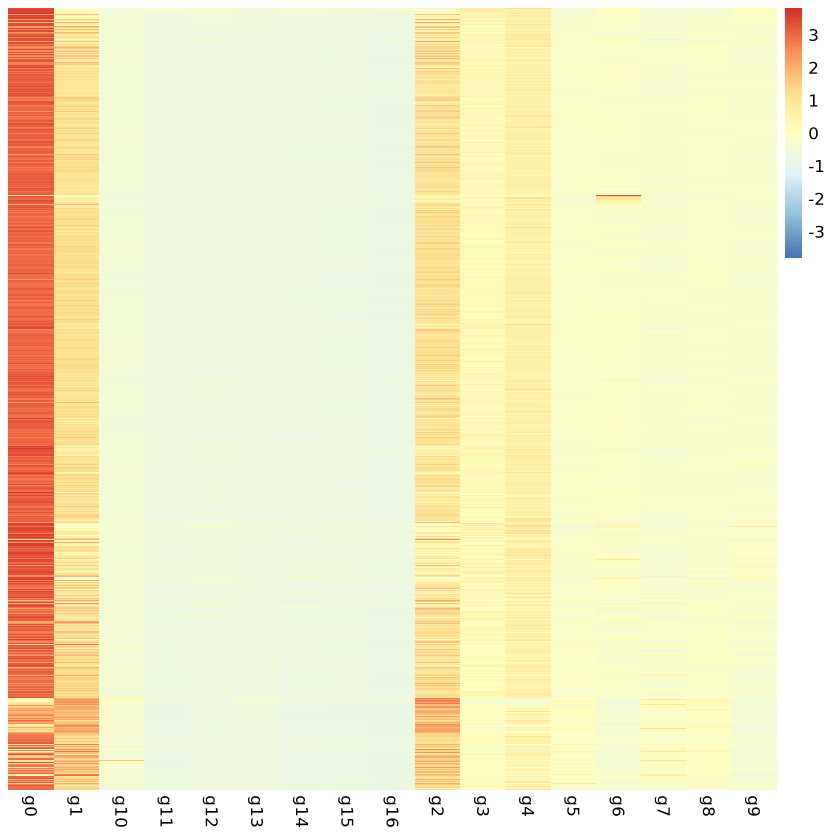

In [17]:
fig2a <- pheatmap::pheatmap(sorted_dar_aver, scale = 'row', cluster_rows = F, cluster_cols = F,
                            show_rownames = FALSE) #520x630

In [18]:
# find cell type specific TF and make a unique list
tf_celltype.df <- FindAllMarkers(sobj, only.pos = T, assay = "chromvar")
unique_tf.list <- unique(tf_celltype.df$gene)
aver_chromvar <- AverageExpression(sobj, assays = "chromvar", features = unique_tf.list) %>%
  as.data.frame()

Calculating cluster DASA_NT

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_HIC2

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_PIAS1

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_CHD2

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_GPBP1L1

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_PQBP1

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_KMT2B

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_SLTM

Warning message in mean.fxn(object[features, cells.1, drop = FALSE]):
“NaNs produced”
Calculating cluster DASA_PLAGL2

Warning message in mean.fxn

In [19]:
# sort the heatmap prior to plotting find column index for maxium value for each TF activity
aver_chromvar <- aver_chromvar[do.call(order, c(aver_chromvar, list(decreasing=TRUE))),]
aver_chromvar$max <- max.col(aver_chromvar)
aver_chromvar <- aver_chromvar[order(aver_chromvar$max), ]
aver_chromvar <- dplyr::select(aver_chromvar, -max)
colnames(aver_chromvar) <- levels(Idents(sobj))

In [16]:
aver_chromvar

,DASA_ADNP,DASA_BRD2,DASA_CHD2,DASA_GPBP1L1,DASA_HIC2,DASA_KMT2B,DASA_NT,DASA_PIAS1,DASA_PLAGL2,DASA_PQBP1,⋯,DMSO_GPBP1L1,DMSO_HIC2,DMSO_KMT2B,DMSO_MNT,DMSO_NT,DMSO_PIAS1,DMSO_SLTM,DMSO_YEATS4,DMSO_ZBED6,DMSO_ZNF669
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MA0140.2,2.22766607,5.2620580,20.2411107,16.6504470,5580.1081119,53.5056787,19.3024703,63.3079736,17.7736962,21.7965250,⋯,-0.71691789,3.3694602,-0.11979103,-0.80651963,-0.60031461,-0.22794950,0.22790276,-0.69334580,-0.70716797,-0.720619496
MA0482.2,0.06744906,0.4919254,2.2759639,2.1733970,11.1880884,7.6720681,1.7600354,6.2356176,0.7365887,3.5252869,⋯,0.27918346,7.8621977,0.69175613,0.45510303,1.10631219,1.55855684,0.77302484,-0.10601724,0.21616655,0.038445248
MA0036.3,0.17680979,0.3759743,1.7803936,2.1341606,12.9403883,10.8273017,1.7570112,5.1834438,0.7229852,4.2484804,⋯,0.26548507,12.0474376,1.26026584,0.43923525,0.75638564,1.43764448,0.85146106,0.03238055,0.40547486,0.132385027
MA0783.1,1.85280307,0.6799056,1.1505782,1.7936341,2.6660773,1.7207172,1.4625497,0.9574911,0.9172581,0.9805576,⋯,0.26213682,0.4968089,0.29064150,0.18646404,0.05937325,-0.13088840,0.24342473,0.21964609,-0.08674998,-0.088469461
MA0524.2,1.07548355,0.7886146,0.7677688,0.8604502,1.7821576,1.6911258,0.9621558,1.3026939,0.6511210,0.6638364,⋯,0.08201388,0.2516465,0.08418799,-0.30954171,0.17220712,-0.06099107,0.17897165,0.30379372,0.30666170,0.003740765
MA0513.1,0.67709308,0.2280547,1.0965566,0.8812721,2.2773044,0.4141161,0.9234539,0.7486901,1.1575111,1.4901890,⋯,0.24486556,1.1558229,0.34720579,0.21740092,0.18375656,0.27459202,0.18443359,0.29755160,0.32813531,0.327285793
MA1527.1,0.50897212,0.6999086,0.9578080,1.0788467,2.6274748,1.4928299,0.8689330,0.9562752,0.8786185,1.2465192,⋯,0.23193857,1.3891807,0.25774969,0.89999984,0.29643137,0.10277356,0.29212724,0.22918756,0.09754238,-0.114116268
MA0678.1,0.74714733,0.4943619,1.0235322,1.0364330,1.1090826,0.8007813,0.8606575,0.9894249,0.7879122,0.6559662,⋯,0.71216821,0.5627868,0.28807076,0.54068227,0.54141589,0.69511309,0.67606618,0.71282163,0.41468062,0.330219388
MA0780.1,0.94220174,0.4091233,0.9377558,0.5647515,1.6720630,0.8381542,0.8447604,0.6757474,0.9480462,0.6180436,⋯,0.28324237,1.6156308,0.56904469,1.16042011,0.57590037,0.44233998,0.67098320,0.84533108,0.25396412,0.363954261


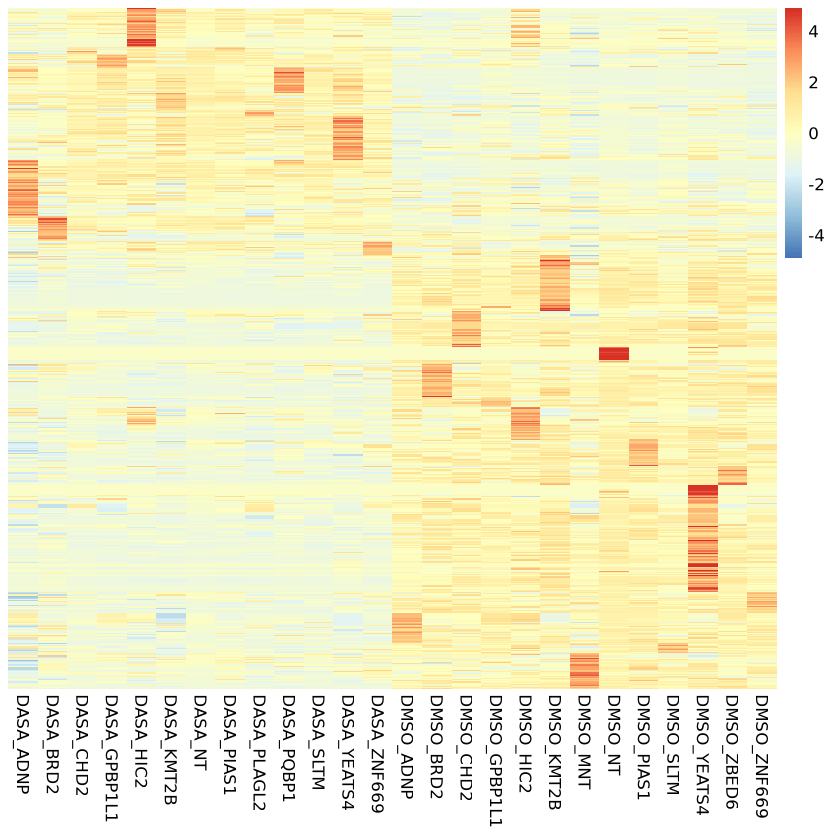

In [21]:
# visualize results
fig3a <- pheatmap::pheatmap(aver_chromvar,scale = "row",
                            cluster_cols=F,cluster_rows = F,
                            #color = jdb_palette("brewer_yes"),
                            show_rownames=F) #450x640

In [ ]:
DefaultAssay(sobj) <- "chromvar"

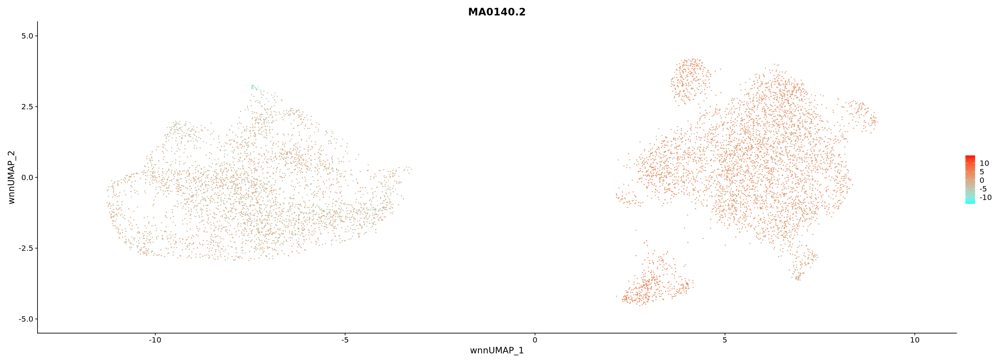

In [ ]:
fig3b_1 <- FeaturePlot(sobj,features = "MA0140.2", reduction = "wnn.umap", cols = c("cyan", "red"), blend.threshold = 0 )
fig3b_1

In [ ]:
sobj

An object of class Seurat 
345588 features across 7994 samples within 5 assays 
Active assay: chromvar (633 features, 0 variable features)
 1 layer present: data
 4 other assays present: SCT, ATAC, RNA, PRTB
 5 dimensional reductions calculated: integrated_lsi, atac.umap, pca, rna.umap, wnn.umap

In [ ]:
Idents(sobj) <- "celltype"
DefaultAssay(sobj) <- 'ATAC'

In [ ]:
saveRDS(sobj, file = "cap2001_sobj_integrated_chromvar.rds")

In [20]:
sobj <- readRDS("cap2001_sobj_integrated_chromvar.rds")

In [21]:
Idents(object = sobj) <- "treatment_and_guidecapture"

In [22]:
DefaultAssay(sobj) <- 'SCT'

In [19]:
deg_aver <- AggregateExpression(sobj, assay = "RNA", return.seurat = T, group.by = "treatment_and_guidecapture")

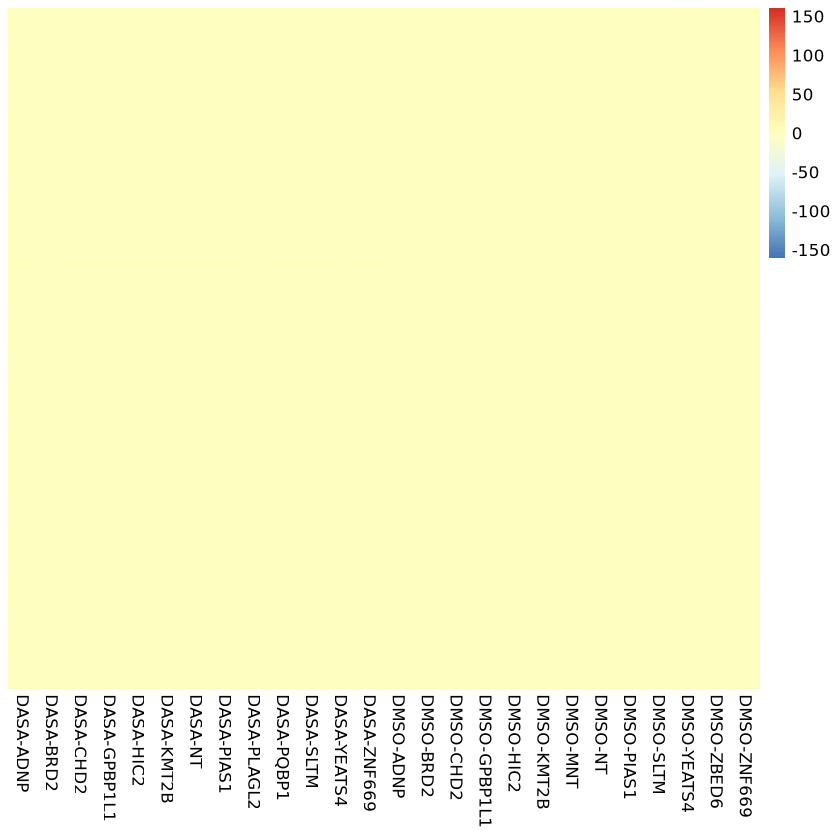

In [15]:
library(pheatmap)
fig_s4 <- pheatmap::pheatmap(deg_aver[["RNA"]], scale = 'column', cluster_rows = F, cluster_cols = F,
                            show_rownames = FALSE) #520x630

In [23]:
deg_aver

An object of class Seurat 
36601 features across 26 samples within 1 assay 
Active assay: RNA (36601 features, 0 variable features)
 2 layers present: counts, data

In [20]:
options(repr.plot.width = 25, repr.plot.height = 25)
DoHeatmap(deg_aver, features = top10$gene, group.by = "treatment_and_guidecapture") + theme(text = element_text(size = 18))

ERROR: Error in eval(expr, envir, enclos): object 'top10' not found


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“ggrepel: 16 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


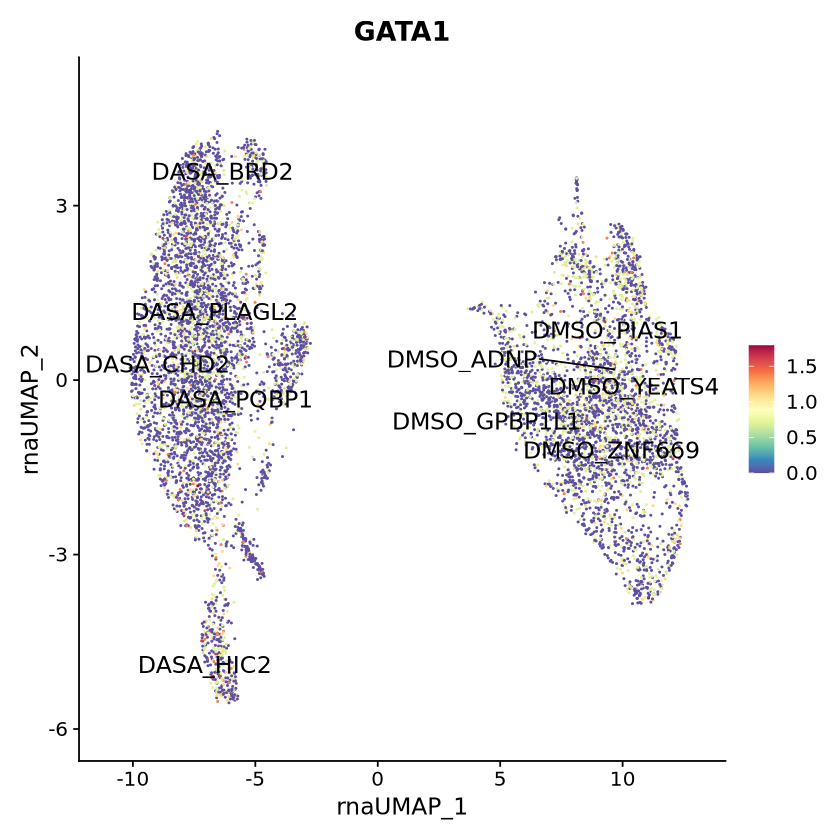

In [6]:
FeaturePlot(object = sobj, features = c("GATA1"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))


In [5]:
GATA1_sobj <- subset(x = sobj, GATA1 > 0.3)

In [6]:
saveRDS(GATA1_sobj, file = "cap2001_sobj_GATA1_filtered.rds")

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“ggrepel: 20 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


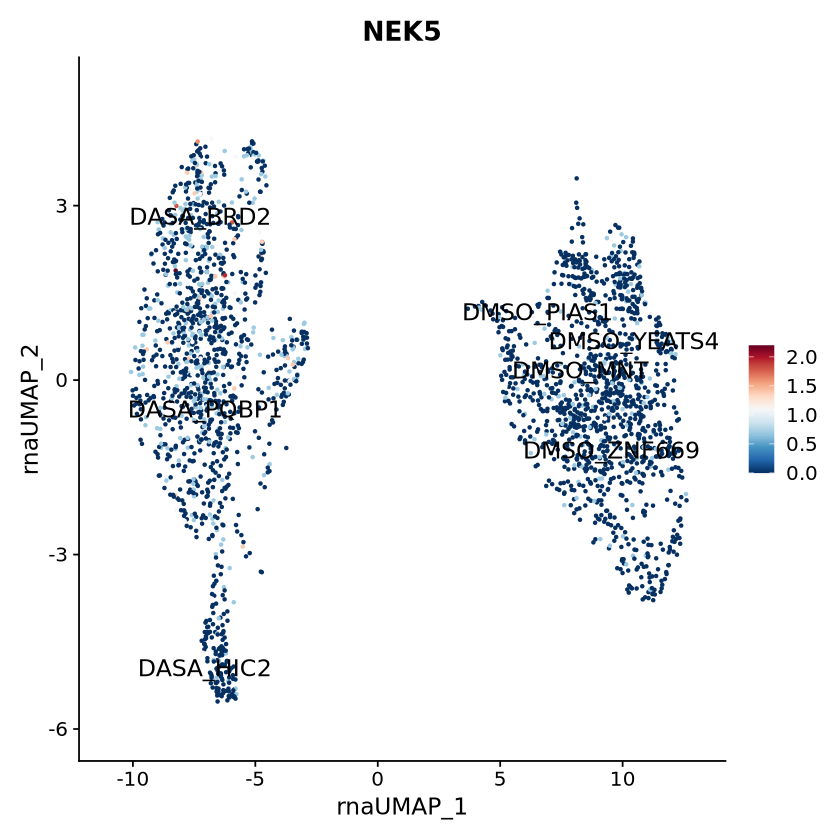

In [25]:
FeaturePlot(object = GATA1_sobj, features = c("NEK5"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

In [16]:
markers <- FindAllMarkers(sobj, only.pos = TRUE, test.use = "wilcox", 
                          min.pct = 0.15)  #return.thresh = 1e-10


Calculating cluster DASA_NT

Calculating cluster DASA_HIC2

Calculating cluster DASA_PIAS1

Calculating cluster DASA_CHD2

Calculating cluster DASA_GPBP1L1

Calculating cluster DASA_PQBP1

Calculating cluster DASA_KMT2B

Calculating cluster DASA_SLTM

Calculating cluster DASA_PLAGL2

Calculating cluster DASA_YEATS4

Calculating cluster DASA_ADNP

Calculating cluster DASA_BRD2

Calculating cluster DASA_ZNF669

Calculating cluster DMSO_KMT2B

Calculating cluster DMSO_CHD2

Calculating cluster DMSO_NT

Calculating cluster DMSO_BRD2

Calculating cluster DMSO_GPBP1L1

Calculating cluster DMSO_HIC2

Calculating cluster DMSO_PIAS1

Calculating cluster DMSO_ZBED6

Calculating cluster DMSO_YEATS4

Calculating cluster DMSO_ZNF669

Calculating cluster DMSO_ADNP

Calculating cluster DMSO_SLTM

Calculating cluster DMSO_MNT



In [17]:
#library(tidyverse)
markers %>%
    group_by(cluster) %>%
    dplyr::filter(avg_log2FC > 1) %>%
    slice_head(n = 10) %>%
    ungroup() -> top10

Warning message in DoHeatmap(sobj, features = top10$gene):
“The following features were omitted as they were not found in the scale.data slot for the SCT assay: MAP3K20, SLC6A9, H19, NDUFAF6, MMAA, MYBL2, SLC2A12, DERL3, POLR3G, CEP55, COLEC11, TMEM273, AC005261.1, AFP, RAPGEF5, KIF21B, S100A4, LINC02573, CRYBG1, CYB5RL, PLEKHA2, AC005532.1, AC011405.1, SDSL, MAG, HYPK, SSPO, HMGN2, AC007383.2, BPGM”


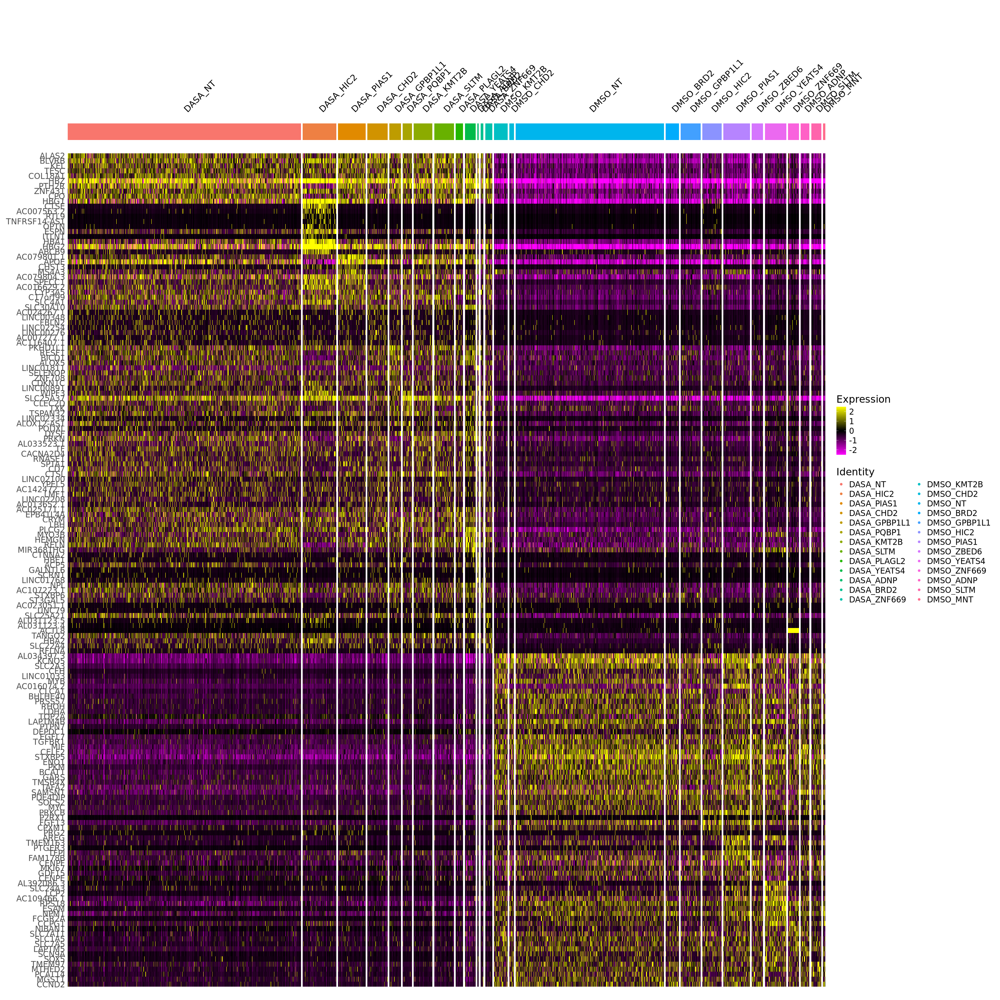

In [22]:
options(repr.plot.width = 25, repr.plot.height = 25)
DoHeatmap(sobj, features = top10$gene) + theme(text = element_text(size = 18))

In [23]:
sub_sobj <- subset(x = sobj, idents = c("DMSO_NT", "DASA_NT", "DASA_HIC2"))

In [30]:
sub_sobj$treatment_and_guidecapture <- factor(sub_sobj$treatment_and_guidecapture, levels = c("DMSO_NT", "DASA_NT", "DASA_HIC2"))

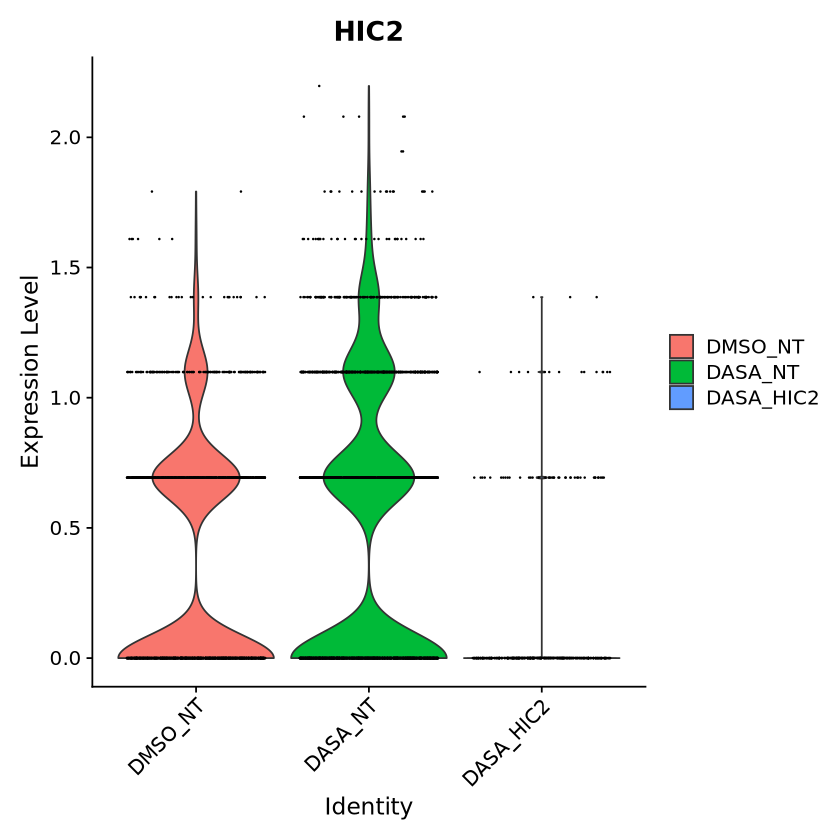

In [25]:
VlnPlot(sub_sobj, features = c("HIC2"), group.by = "treatment_and_guidecapture", assay = "SCT")
options(repr.plot.width=8, repr.plot.height=8)

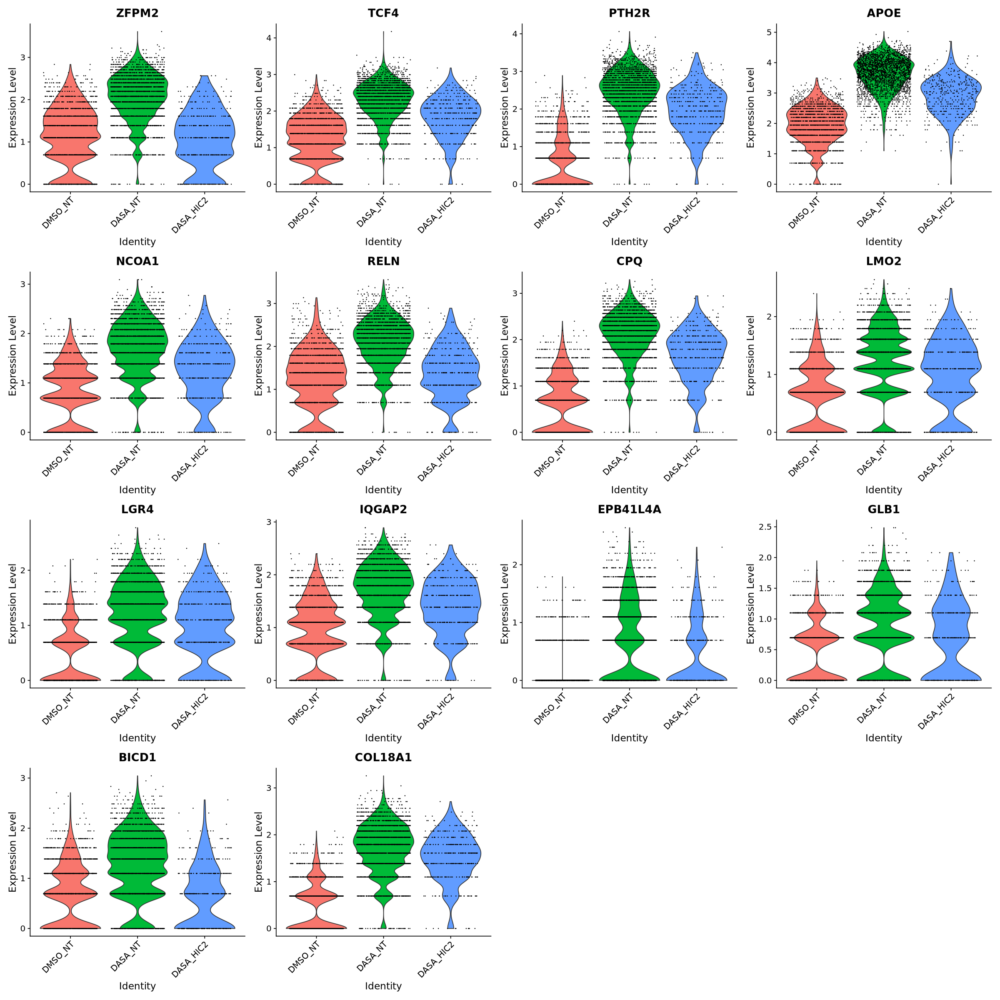

In [31]:
VlnPlot(sub_sobj, features = c("ZFPM2", "TCF4", "PTH2R", "APOE", "NCOA1", "RELN", "CPQ", "LMO2", "LGR4", "IQGAP2", "EPB41L4A", "GLB1", "BICD1", "COL18A1"), group.by = "treatment_and_guidecapture")
options(repr.plot.width=20, repr.plot.height=20)

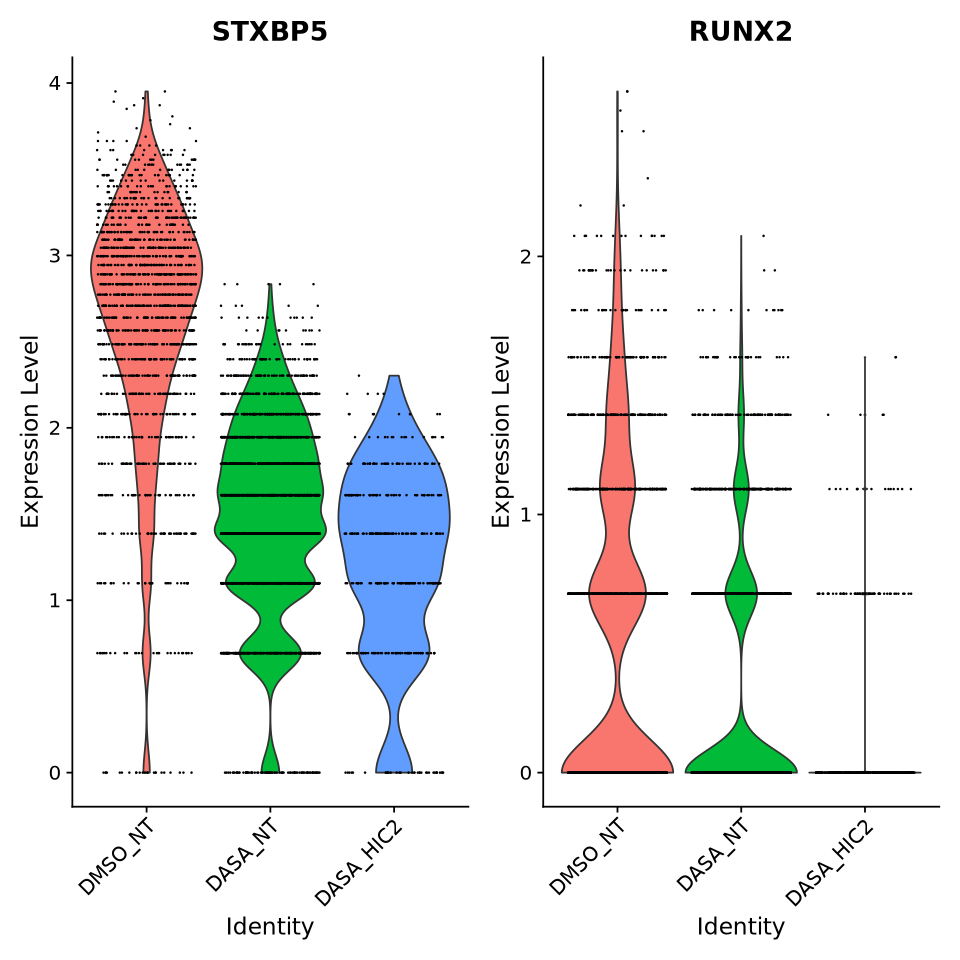

In [33]:
VlnPlot(sub_sobj, features = c("STXBP5", "RUNX2"), group.by = "treatment_and_guidecapture", assay = "SCT")
options(repr.plot.width=4, repr.plot.height=4)

Warning message:
“Could not find MA0738.1 in the default search locations, found in ‘chromvar’ assay instead”


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


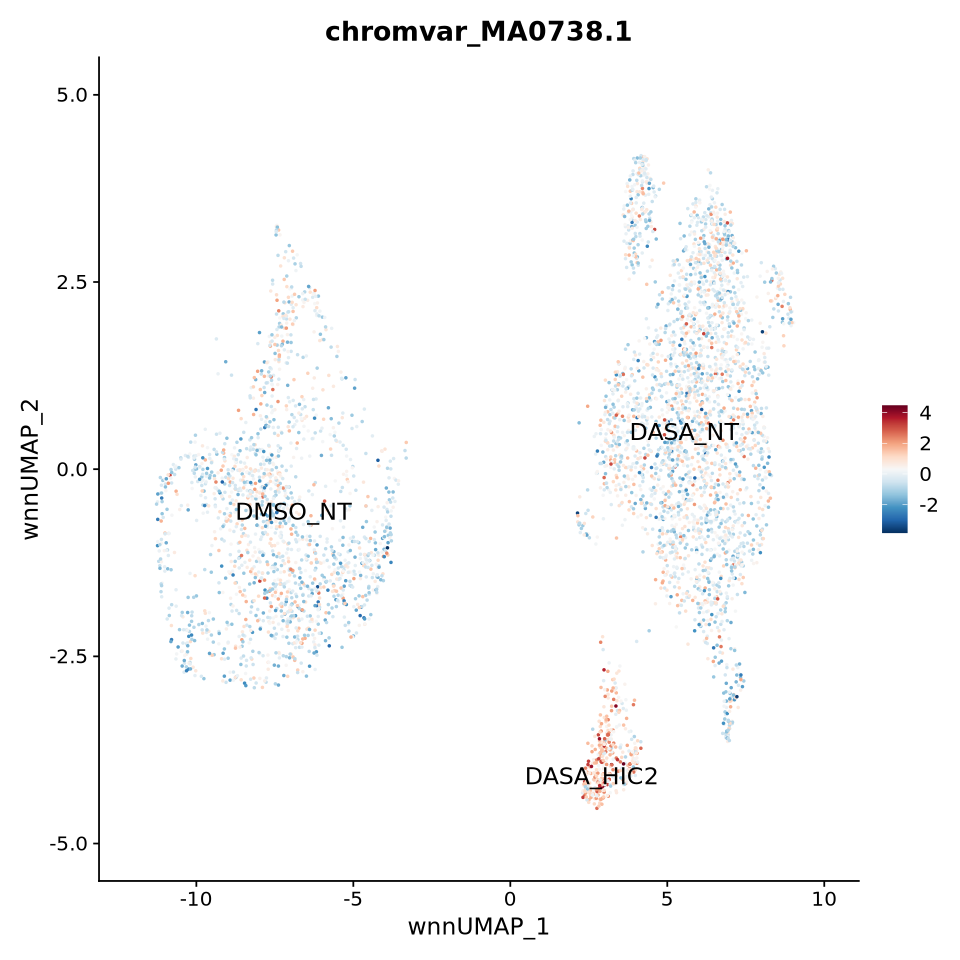

In [34]:
DefaultAssay(sobj) <- 'chromvar'
FeaturePlot(sub_sobj, features = c("MA0738.1"), reduction = "wnn.umap", label = TRUE,label.size = 5, repel = TRUE)+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


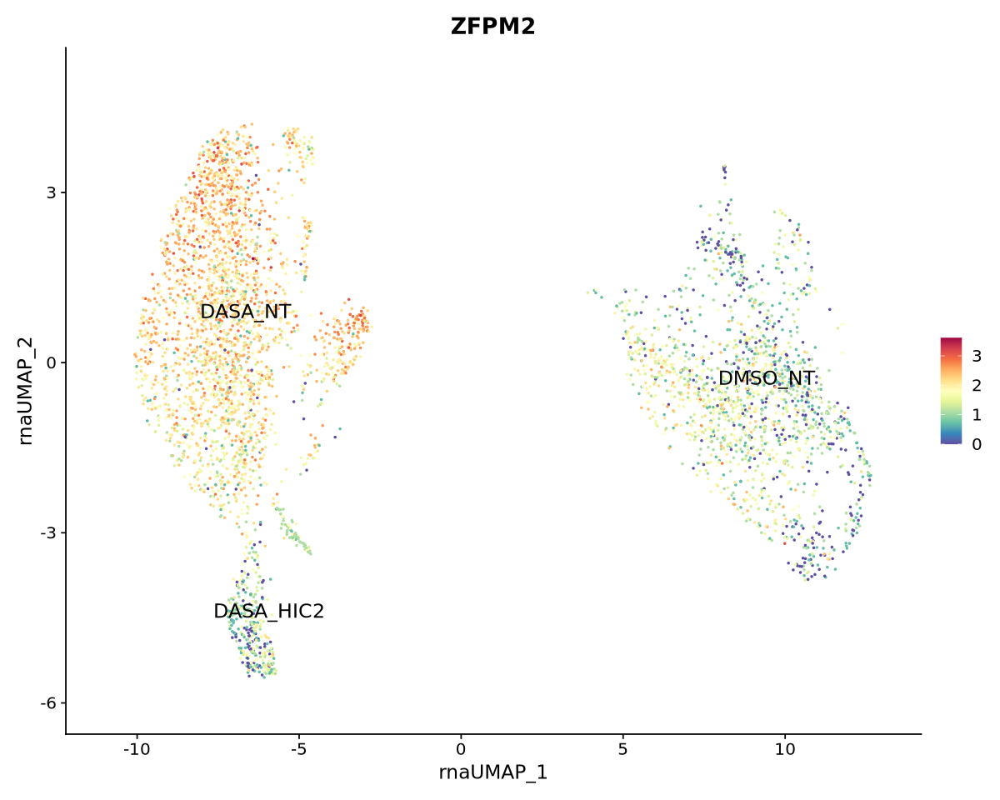

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


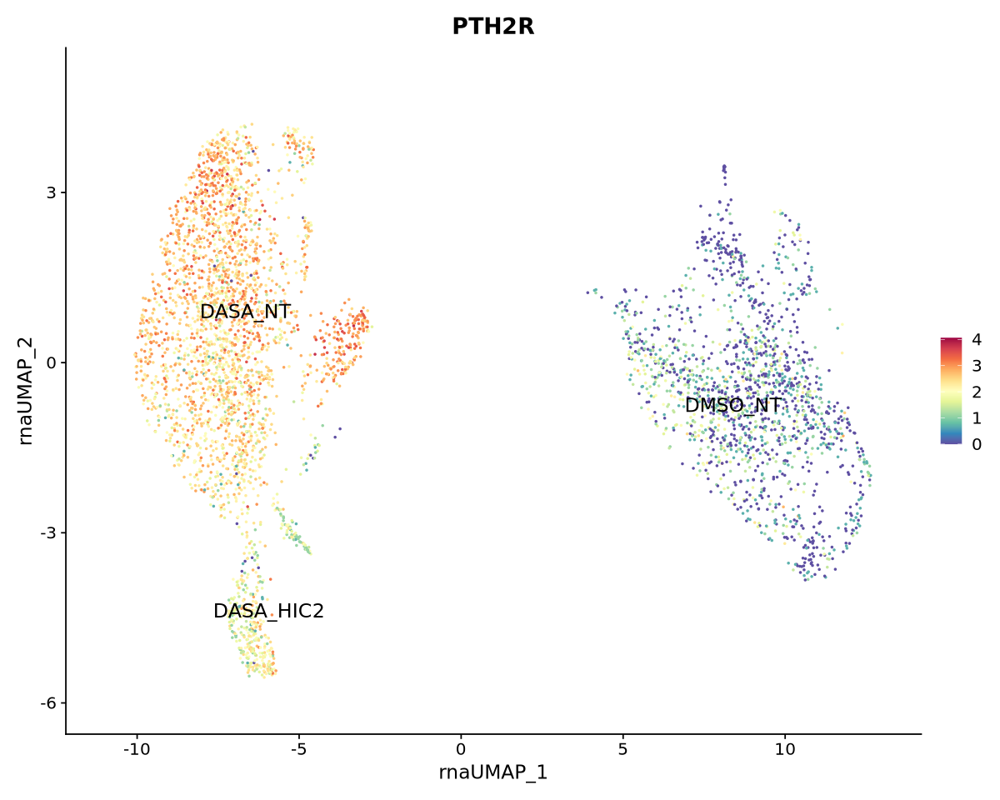

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


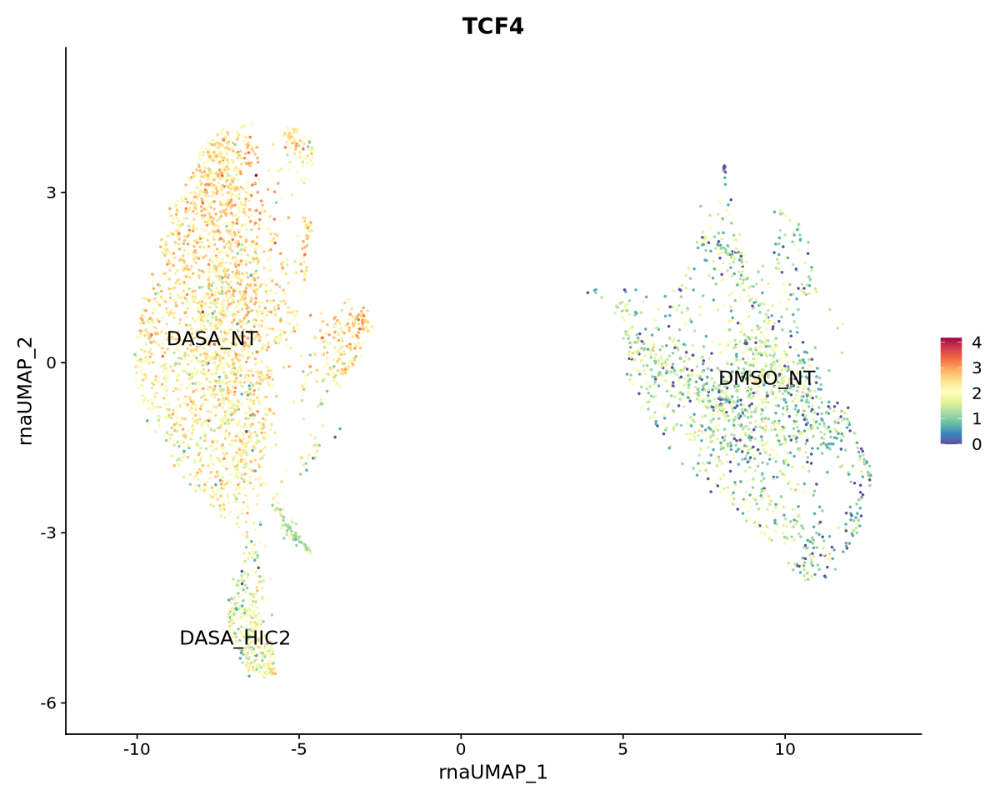

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


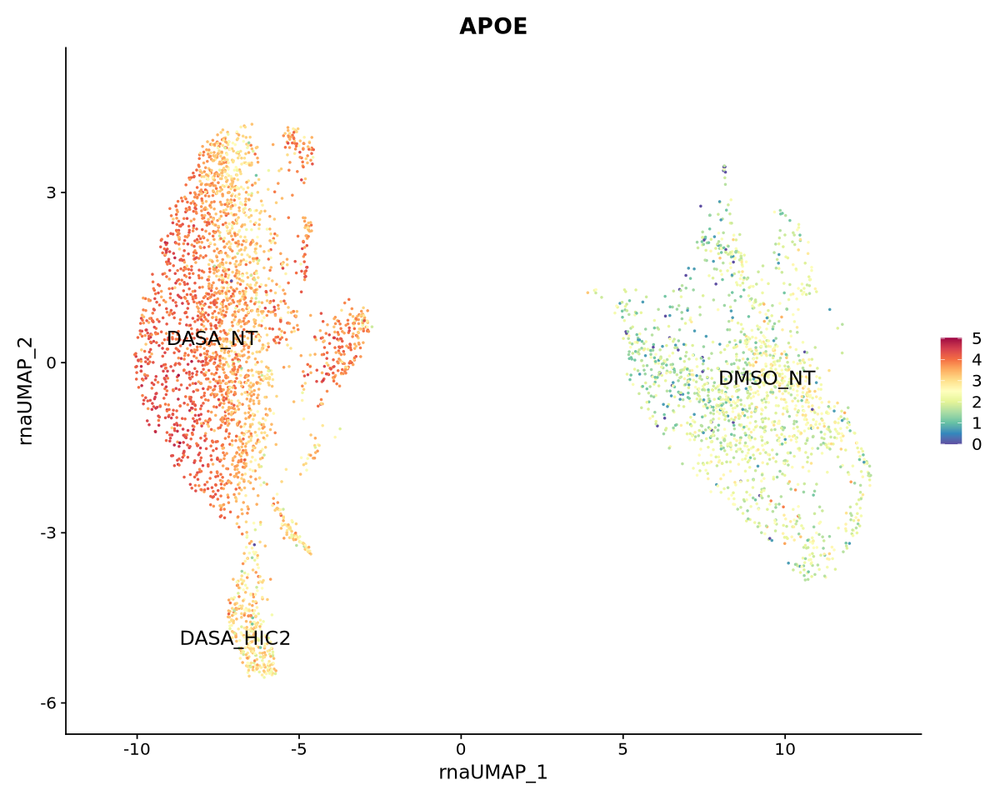

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


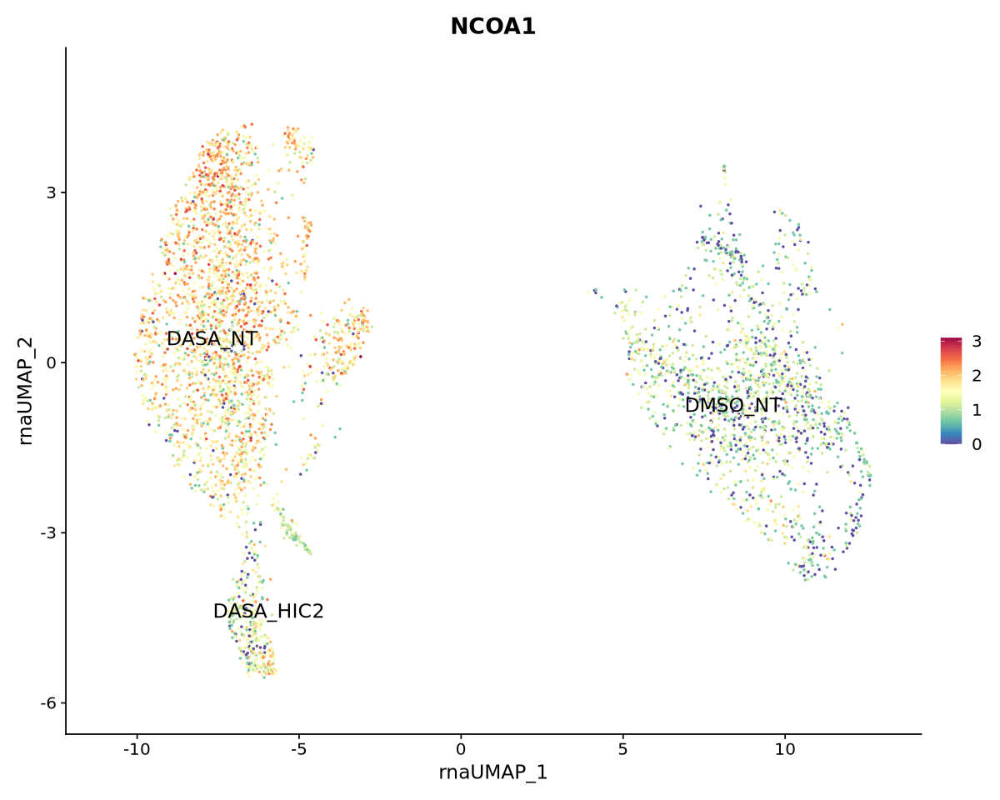

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


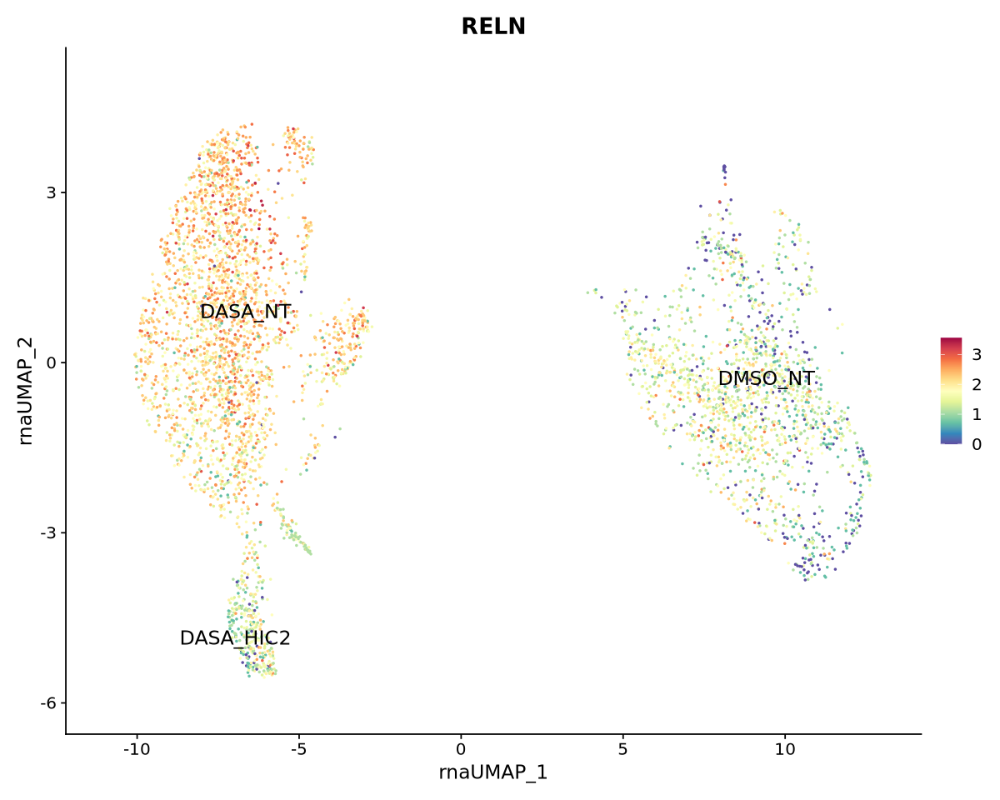

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


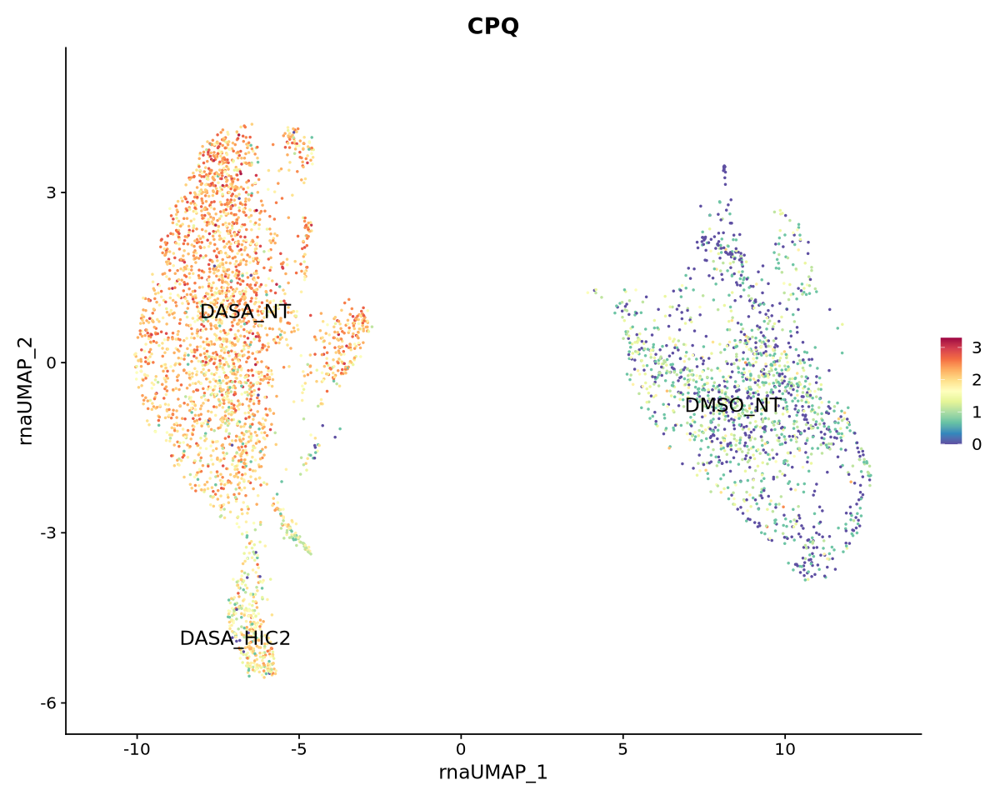

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


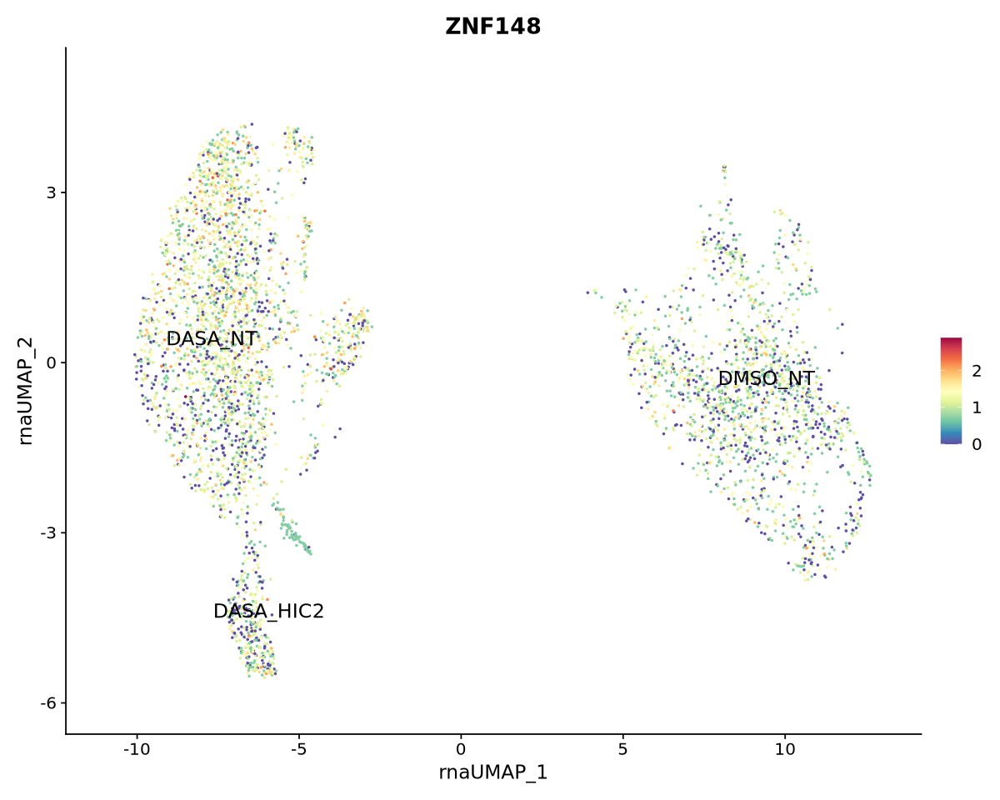

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


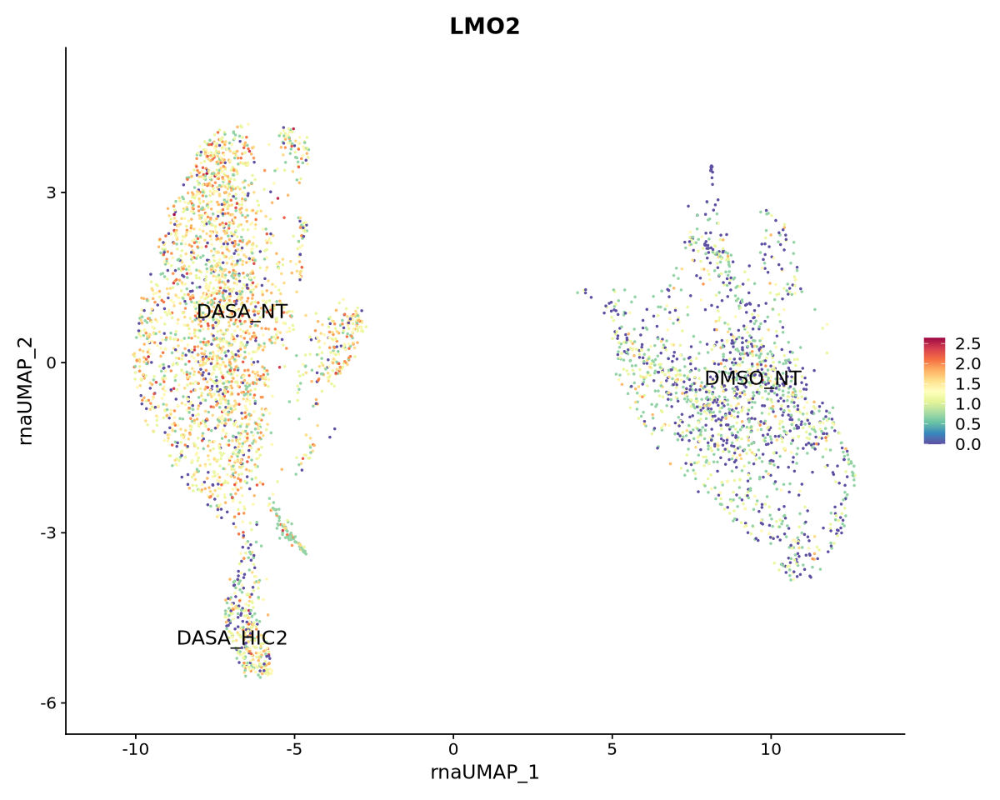

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


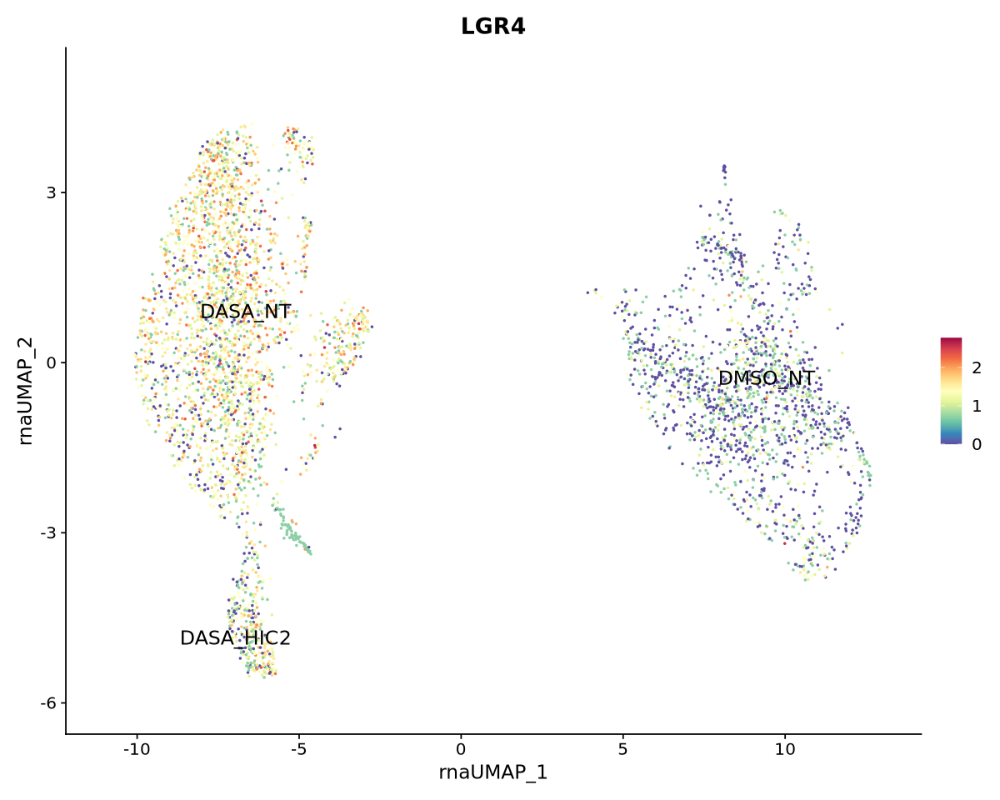

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


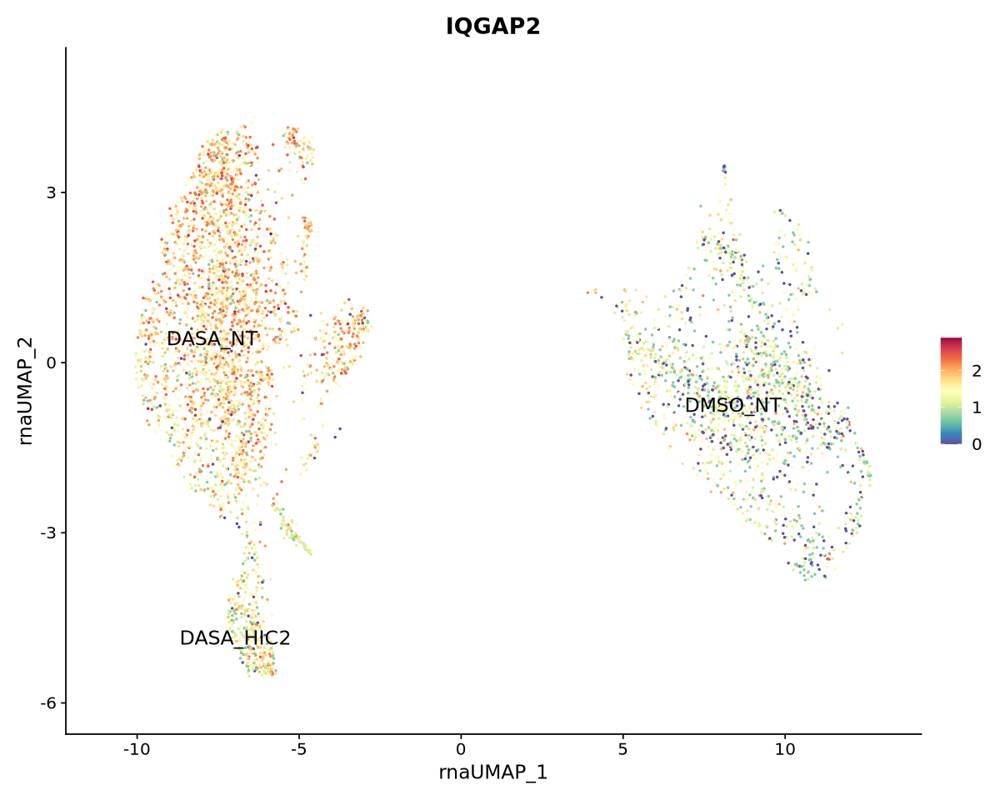

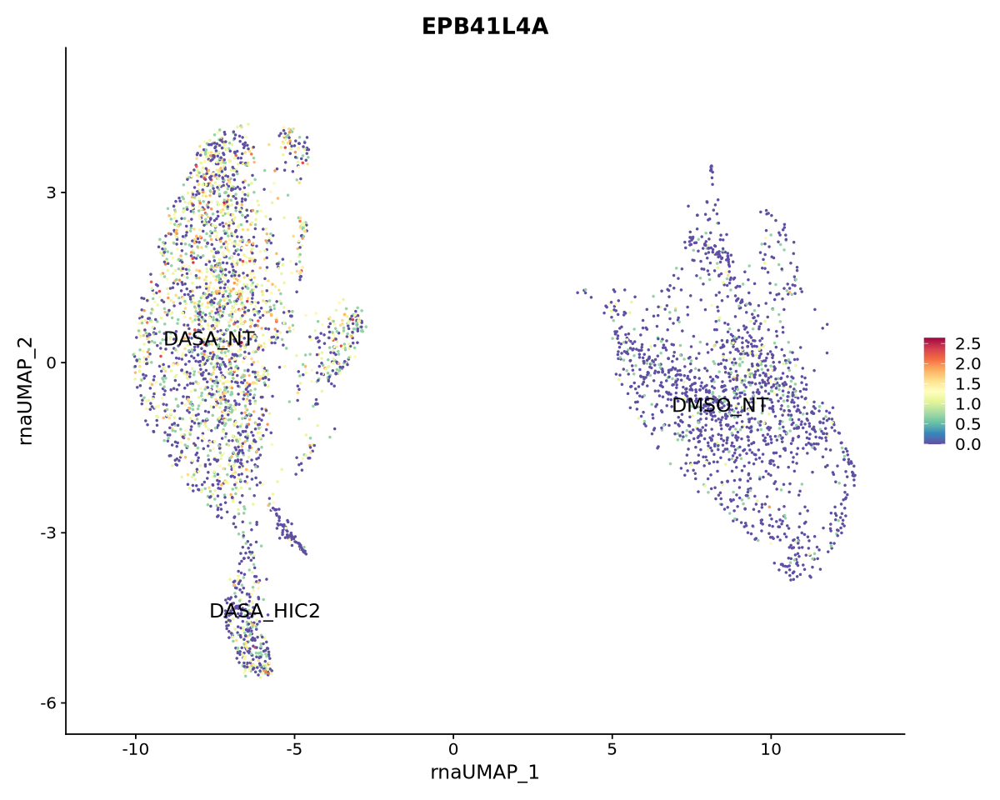

In [9]:
options(repr.plot.width = 10, repr.plot.height = 8)
FeaturePlot(object = sub_sobj, features = c("ZFPM2"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("PTH2R"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("TCF4"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("APOE"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("NCOA1"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("RELN"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("CPQ"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("ZNF148"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("LMO2"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("LGR4"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("IQGAP2"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))
FeaturePlot(object = sub_sobj, features = c("EPB41L4A"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


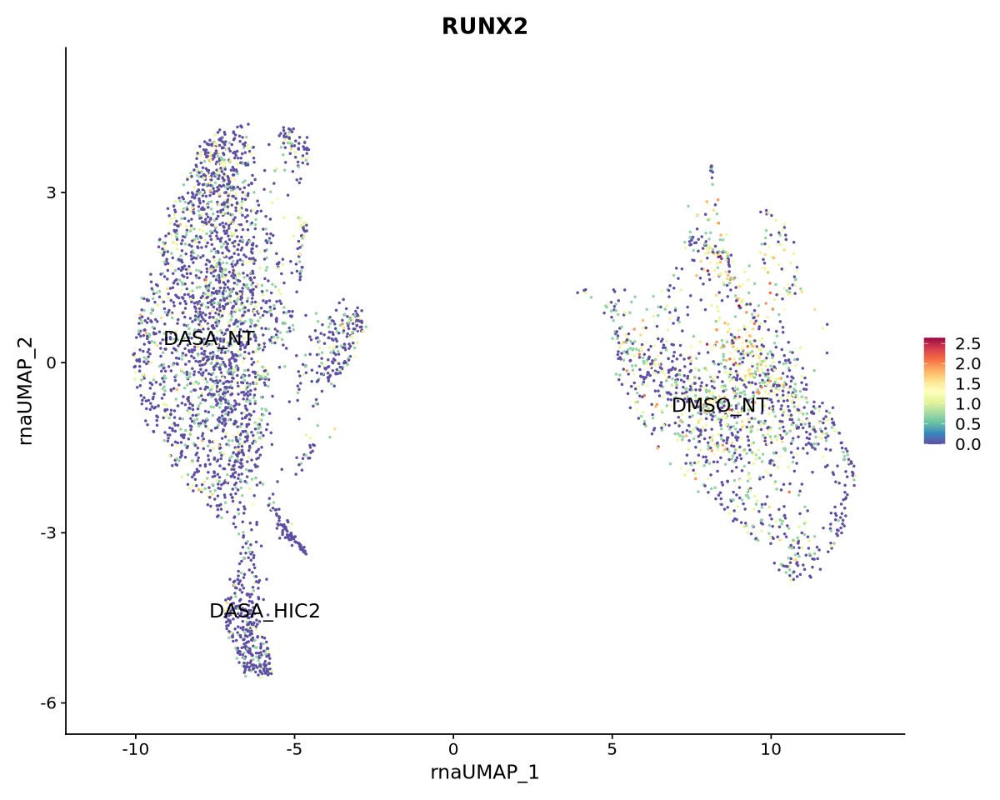

In [10]:
FeaturePlot(object = sub_sobj, features = c("RUNX2"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


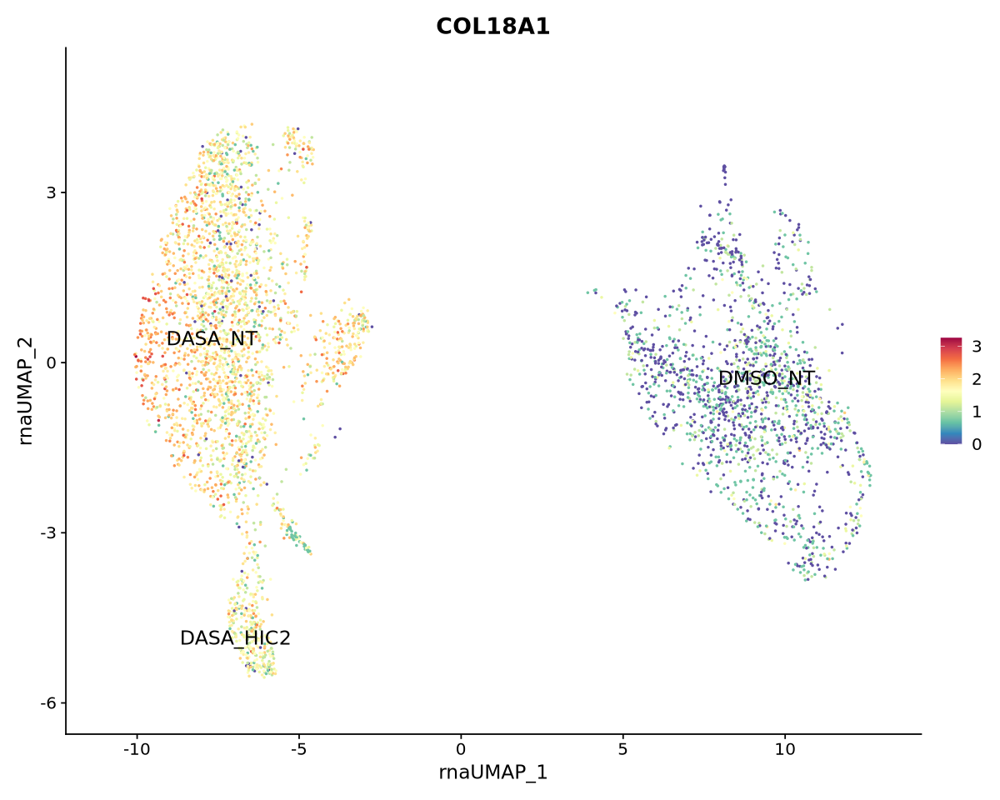

In [43]:
FeaturePlot(object = sub_sobj, features = c("COL18A1"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


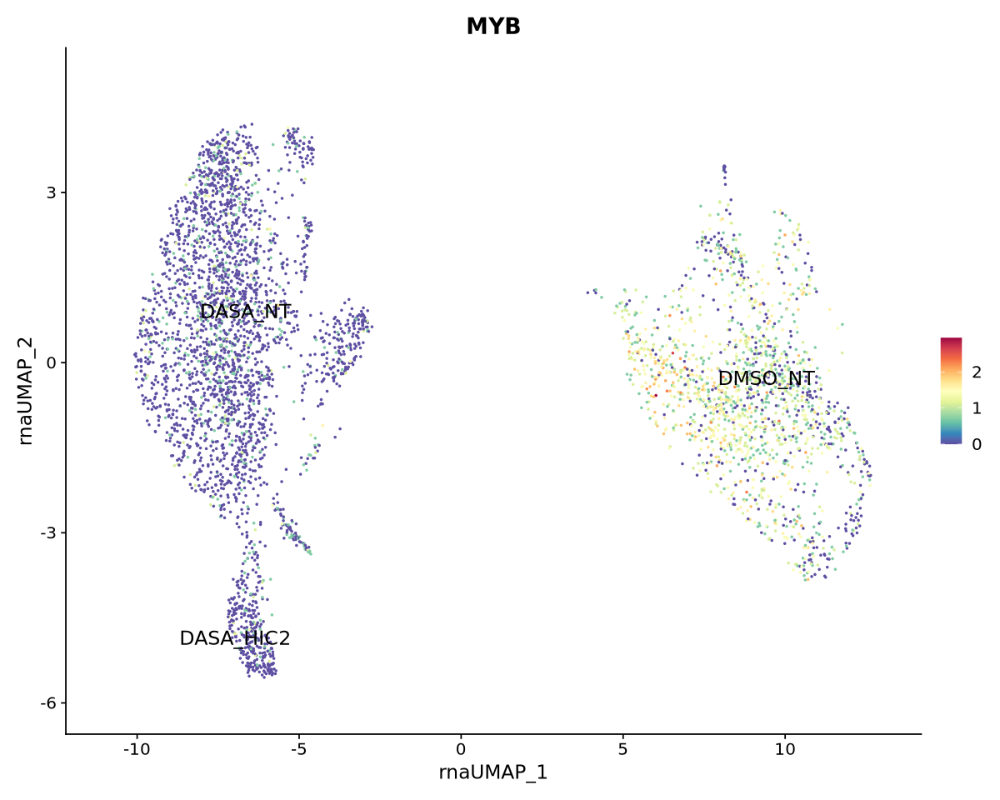

In [40]:
FeaturePlot(object = sub_sobj, features = c("MYB"), reduction = "rna.umap", label = TRUE, label.size = 5, repel = TRUE )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))

In [6]:
library(RColorBrewer)

Warning message:
“Could not find MA0738.1 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


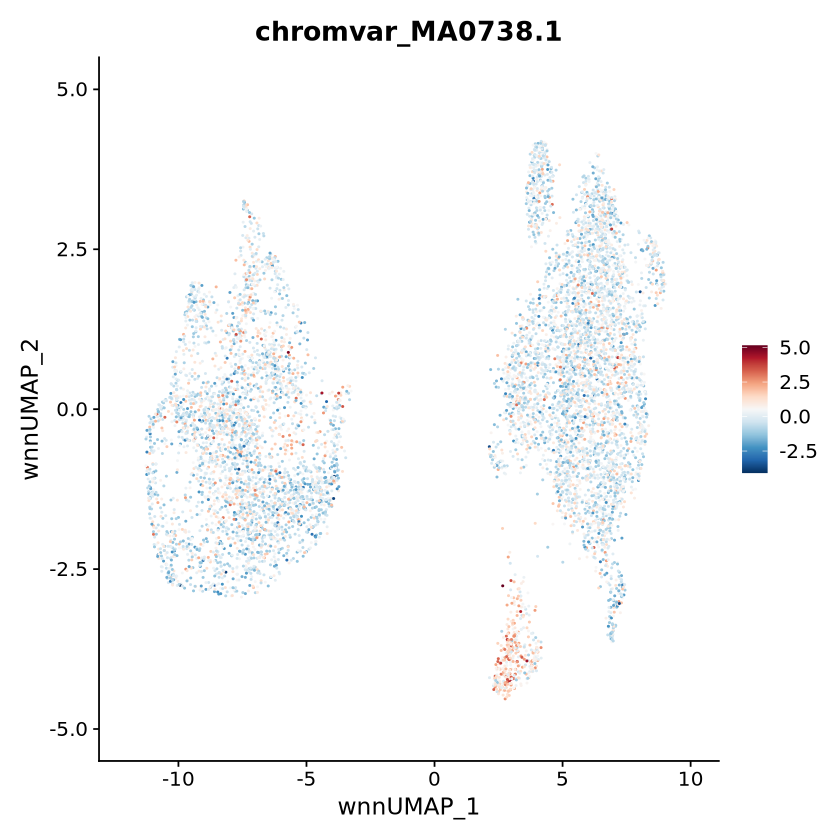

In [7]:
#fig3b_1 <- FeaturePlot(sobj,features = "MA0738.1", reduction = "wnn.umap", cols = c("blue", "red"), blend.threshold = 0 )
#fig3b_1
#HIC2
FeaturePlot(object = sobj, features = c("MA0738.1"), reduction = "wnn.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Warning message:
“Could not find MA0766.2 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


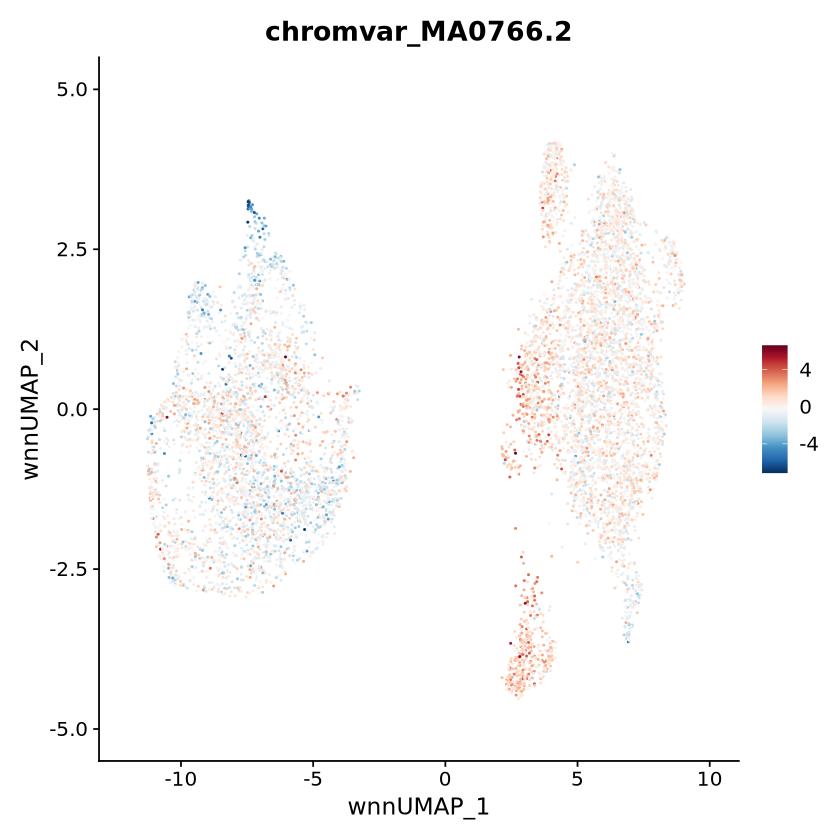

In [ ]:
#GATA5
FeaturePlot(object = sobj, features = c("MA0766.2"), reduction = "wnn.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Warning message:
“Could not find MA0140.2 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


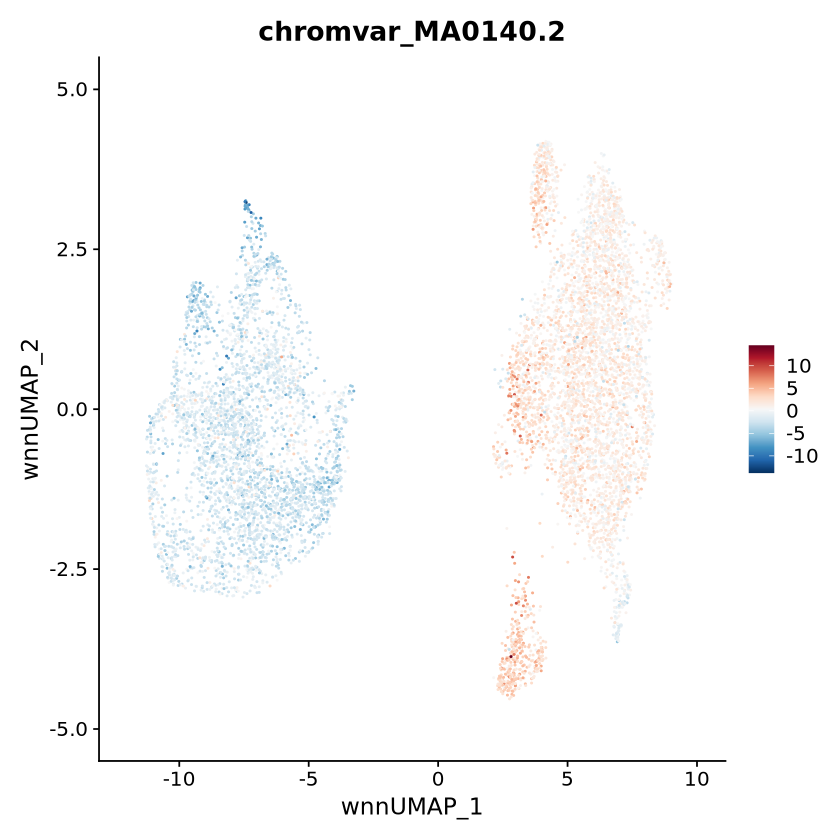

In [ ]:
#GATA1
FeaturePlot(object = sobj, features = c("MA0140.2"), reduction = "wnn.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Warning message:
“Could not find MA1540.1 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


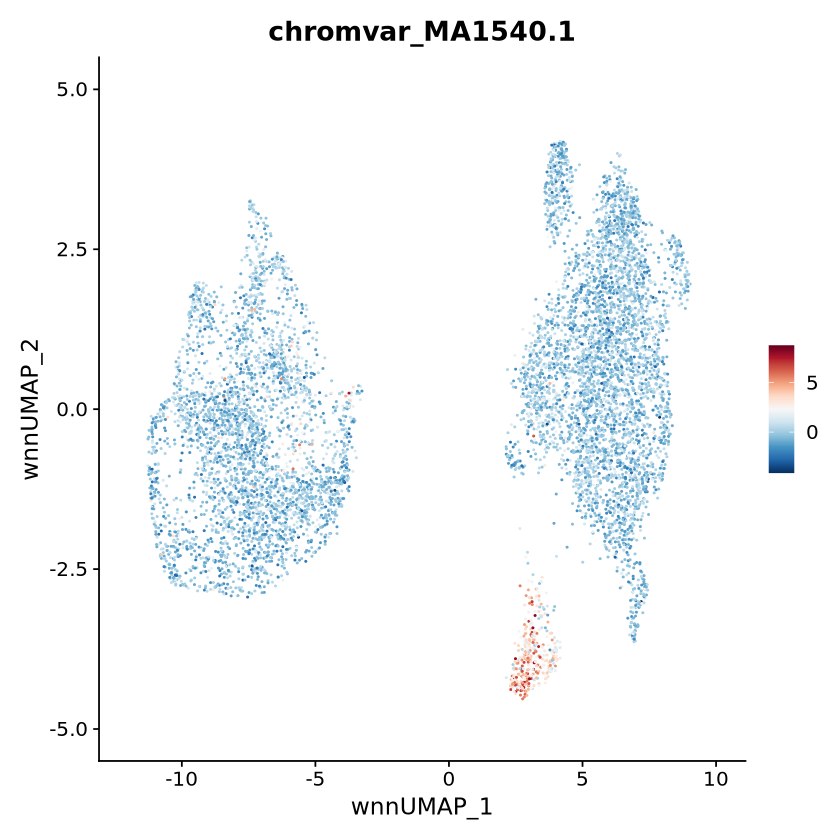

In [ ]:
#NR5A1
FeaturePlot(object = sobj, features = c("MA1540.1"), reduction = "wnn.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Warning message:
“Could not find MA0137.3 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


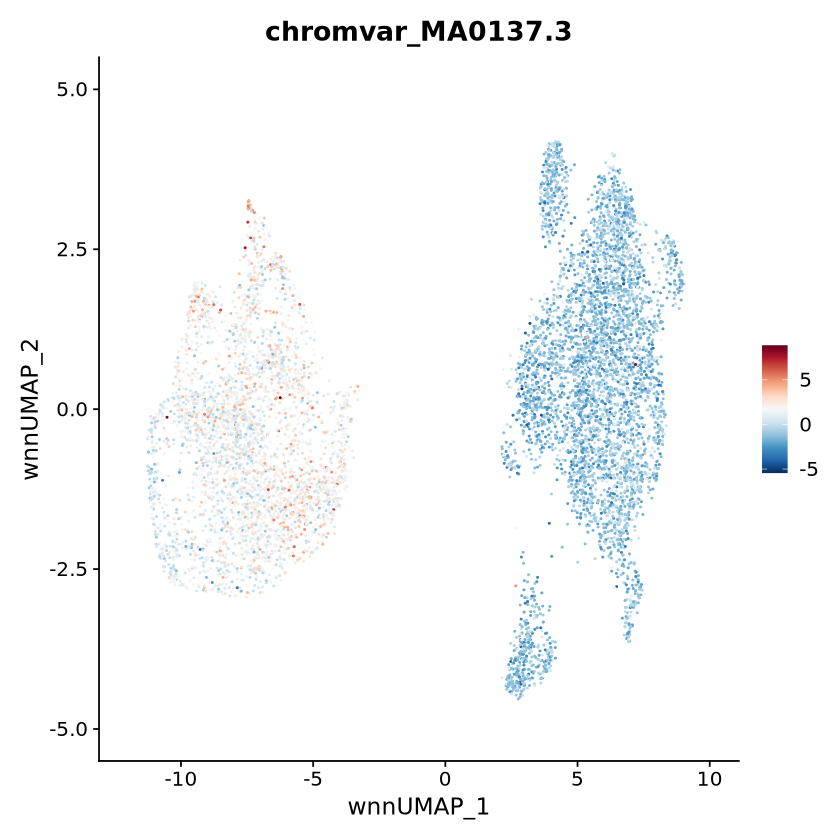

In [8]:
#STAT1
FeaturePlot(object = sobj, features = c("MA0137.3"), reduction = "wnn.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Warning message:
“Could not find MA0830.2 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


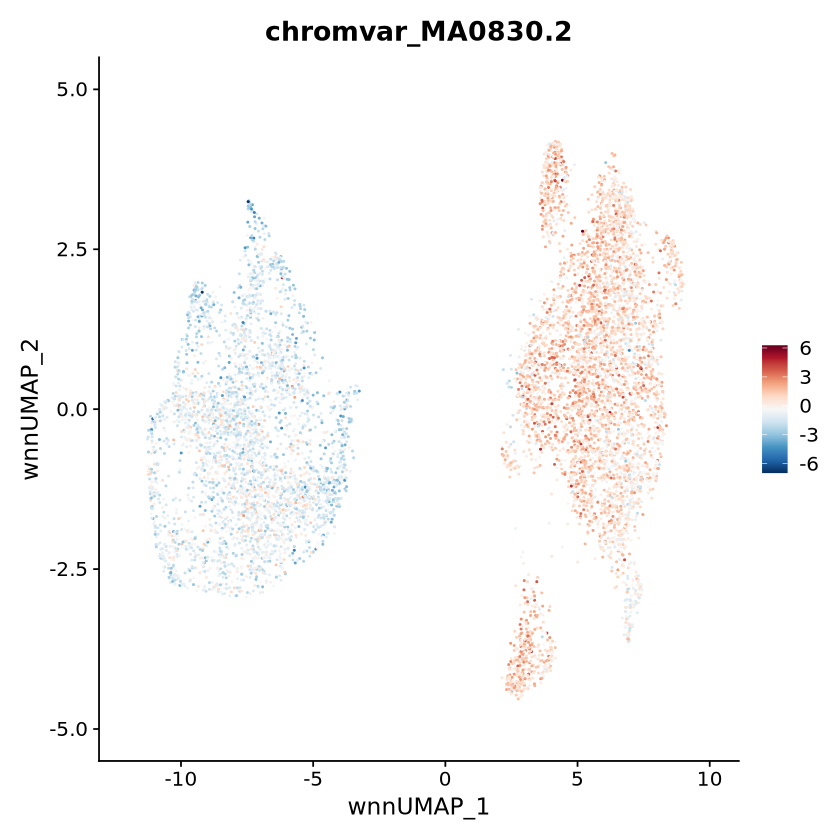

In [17]:
#ZFPM2
FeaturePlot(object = sobj, features = c("MA0830.2"), reduction = "wnn.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "RdBu")))

Warning message:
“Could not find MA1540.1 in the default search locations, found in ‘chromvar’ assay instead”
Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


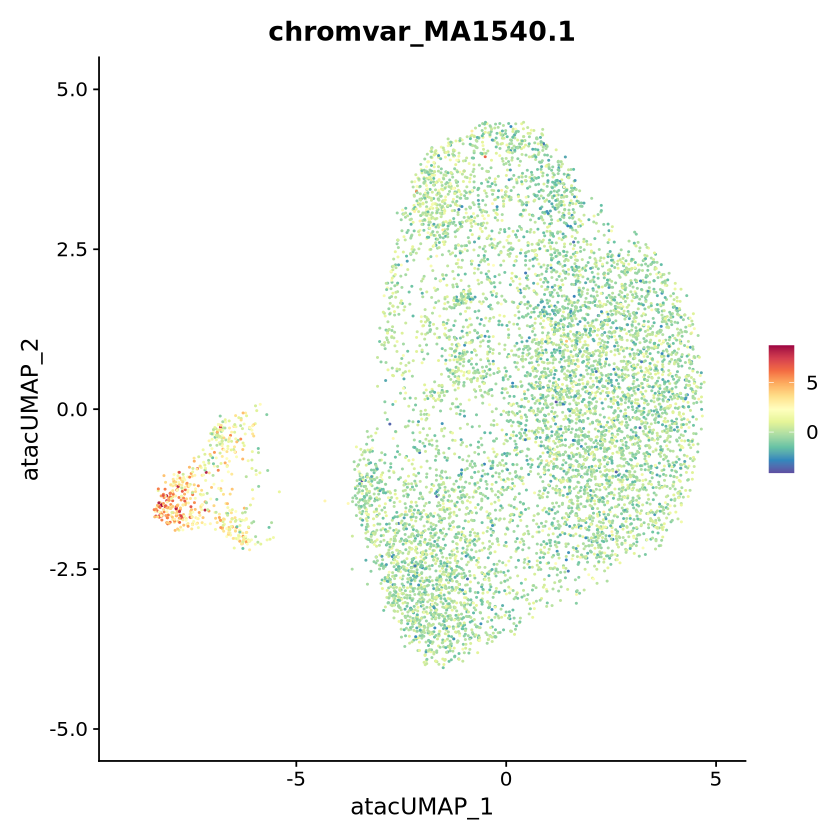

In [24]:
#NR5A1
FeaturePlot(object = sobj, features = c("MA1540.1"), reduction = "atac.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))

Warning message:
“Could not find MA1633.1 in the default search locations, found in ‘chromvar’ assay instead”


Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


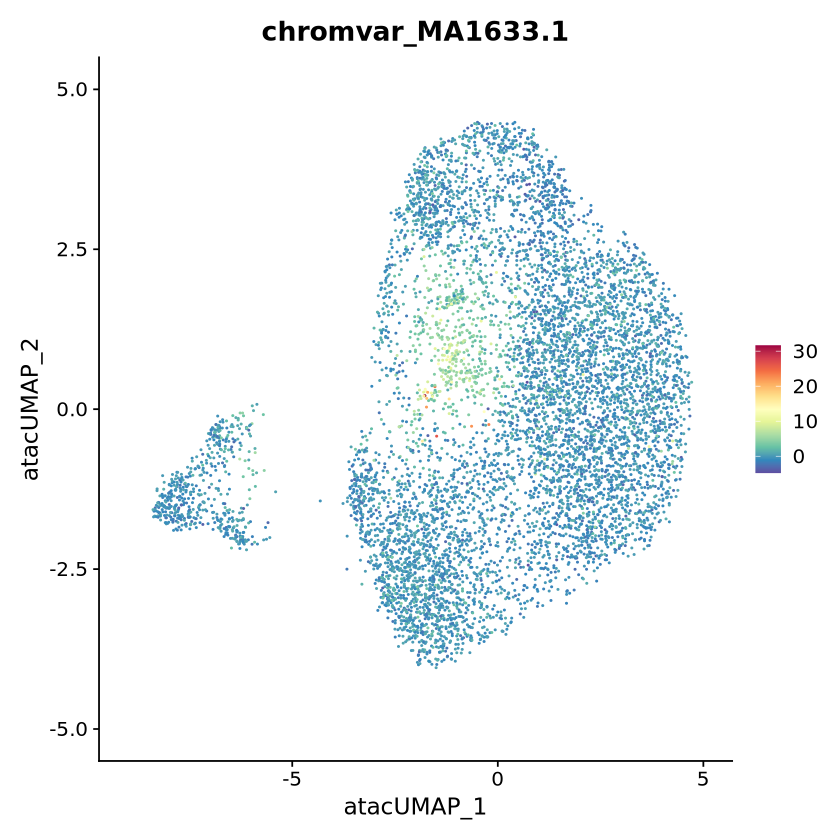

In [23]:
#BACH1
FeaturePlot(object = sobj, features = c("MA1633.1"), reduction = "atac.umap" )+ scale_colour_gradientn(colours = rev(brewer.pal(n = 11, name = "Spectral")))

In [23]:
cov_plot <- CoveragePlot(
  object = sobj,
  region = "chr22-19933251-19934308",
  annotation = FALSE,
  peaks = FALSE
)

ERROR: Error: TabixFile: Fragment file is not indexed.


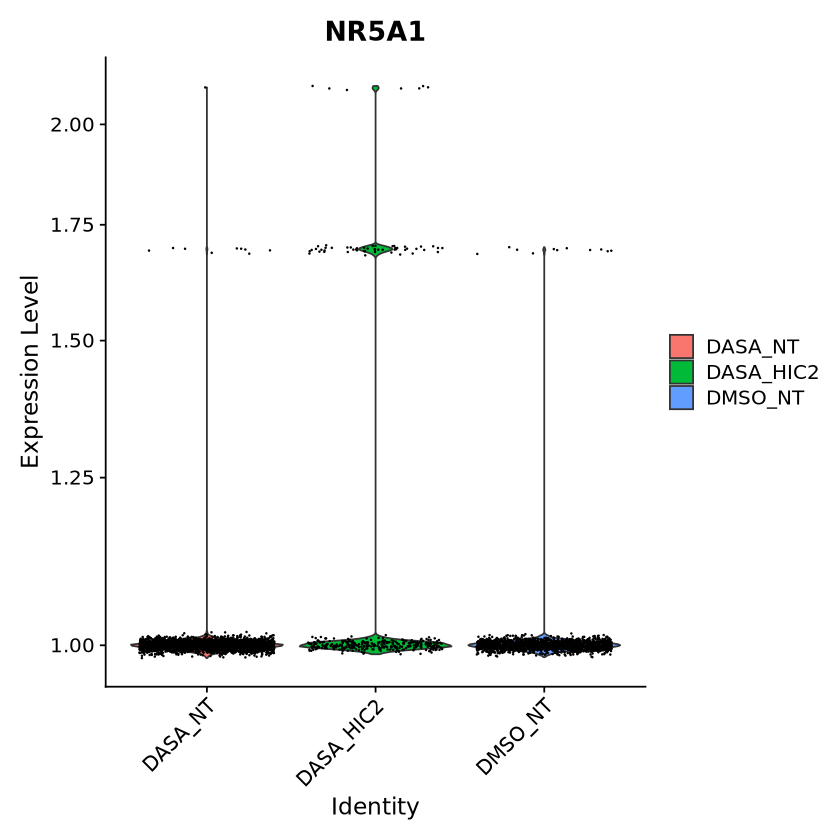

In [6]:
VlnPlot(object = sobj, features = "NR5A1", assay = "SCT", idents = c("DASA_NT", "DASA_HIC2", "DMSO_NT"), log = TRUE)